In [ ]:
# ruff: noqa: E402, F601, E741, I001, UP015


<div style="
    background-color: #f7f7f7;
    background-image: url(''), url('') ;
    background-position: left bottom, right top;
    background-repeat: no-repeat,  no-repeat;
    background-size: auto 60px, auto 160px;
    border-radius: 5px;
    box-shadow: 0px 3px 1px -2px rgba(0, 0, 0, 0.2), 0px 2px 2px 0px rgba(0, 0, 0, 0.14), 0px 1px 5px 0px rgba(0,0,0,.12);">

<h1 style="
    color: #2a4cdf;
    font-style: normal;
    font-size: 2.25rem;
    line-height: 1.4em;
    font-weight: 600;
    padding: 30px 200px 0px 30px;"> 
        Perovscribe Evals</h1>

<p style="
    line-height: 1.4em;
    padding: 30px 200px 0px 30px;">
    This notebook runs through the analysis of the Perovscribe extraction pipeline to compute extraction performance metrics
</p>

</div>

## Overview

This notebook evaluates the performance of the Perovscribe extraction pipeline by comparing extracted data against a ground truth dataset. The evaluation covers multiple Large Language Models (LLMs) and compares their extraction performance across different data fields.


### Evaluation Methodology

The evaluation uses a **confusion matrix** approach:
- **True Positives (TP)**: Fields correctly extracted and matching ground truth
- **False Positives (FP)**: Fields extracted but not present in ground truth
- **False Negatives (FN)**: Fields in ground truth but not extracted

**Metrics calculated**:
- **Precision** = TP / (TP + FP) - Measures extraction accuracy
- **Recall** = TP / (TP + FN) - Measures extraction completeness
- **F1 Score** = 2 × (Precision × Recall) / (Precision + Recall) - Harmonic mean of precision and recall


## Setup and Evaluations

The evaluation is done by comparing the extracted data to a ground truth dataset.
Sometimes, the scoring will use an LLM to score the extracted data.

For this reason, we need API keys for the LLMs we are using.

### Imports & Setup

In [1]:
# --- Imports ---
import json
import os
from importlib.resources import files
from math import pi
from pathlib import Path


import dabest
import litellm
from litellm.caching.caching import Cache

litellm.cache = Cache(type='disk')
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from tqdm import tqdm

# Third-party libraries
from dotenv import load_dotenv


# Internal modules
# Ensure 'perovscribe' is accessible in the repo structure
from perovscribe.pipeline import ExtractionPipeline
from plotly_theme import register_template, set_defaults, MODEL_COLORS

# --- Configuration & Theme ---
load_dotenv()  # Loads .env if present
register_template()
set_defaults()

plt.rcParams.update(
    {
        'font.family': 'Arial',
        'font.size': 10,
        'axes.labelsize': 11,
        'axes.titlesize': 12,
        'xtick.labelsize': 10,
        'ytick.labelsize': 10,
        'legend.fontsize': 10,
        'figure.titlesize': 12,
        'axes.linewidth': 1,
        'axes.edgecolor': 'black',
        'axes.facecolor': 'white',
        'figure.facecolor': 'white',
        'grid.color': 'lightgray',
        'grid.linewidth': 0.5,
        'axes.grid': False,
        'axes.spines.top': True,
        'axes.spines.right': True,
        'savefig.dpi': 300,
        'savefig.bbox': 'tight',
        'savefig.facecolor': 'white',
    }
)
# Define Paths (Use relative paths for reproducibility!)
DATA_DIR = files('perovscribe').joinpath('data')
EXTRACTIONS_DIR = DATA_DIR / 'extractions'
GROUND_TRUTH_DIR = DATA_DIR / 'ground_truth' / 'test'
DEV_DIR = DATA_DIR / 'ground_truth' / 'dev'
EXPERTS_DIR = EXTRACTIONS_DIR / 'humans' / 'Consensus'
# MODEL_COLORS is imported from plotly_theme (single source of truth for colors)

Pre-compiling numba functions for DABEST...


Compiling numba functions: 100%|██████████| 11/11 [00:00<00:00, 61.77it/s]

Numba compilation complete!



22:39:14 - LiteLLM:ERROR: redis_cache.py:178 - Error connecting to Sync Redis client


22:39:15 - LiteLLM:ERROR: redis_cache.py:1081 - LiteLLM Redis Cache PING: - Got exception from REDIS : Error 61 connecting to 127.0.0.1:6379. Connect call failed ('127.0.0.1', 6379).


In [2]:
# ============================================================================
# COUNT DEVICES IN TEST AND VALIDATION SETS
# ============================================================================


def count_devices_in_directory(ground_truth_dir):
    """
    Count the number of devices in a ground truth directory.

    Each JSON file contains a "cells" list, where each element represents a device.
    This function counts the length of the "cells" list in each file.

    Args:
        ground_truth_dir: Path to ground truth directory

    Returns:
        dict with 'files' (number of JSON files), 'total_devices' (sum of len(cells)),
        and 'papers' (number of unique papers/DOIs)
    """
    if not ground_truth_dir.exists():
        return {'files': 0, 'total_devices': 0, 'papers': 0}

    json_files = list(ground_truth_dir.glob('*.json'))
    num_files = len(json_files)

    # Count devices from "cells" list in each JSON file
    total_devices = 0
    papers_with_devices = set()

    for json_file in json_files:
        try:
            with open(json_file, 'r') as f:
                data = json.load(f)

            # Count devices: length of "cells" list
            if isinstance(data, dict) and 'cells' in data:
                devices_in_file = len(data['cells'])
                total_devices += devices_in_file

                # Extract DOI from filename (format: DOI.json)
                # Filename format is like "10.1002--adma.202305822.json"
                doi = json_file.stem.replace('--', '/')
                papers_with_devices.add(doi)
            else:
                # Fallback: if structure is unexpected, count as 1 device
                total_devices += 1

        except (json.JSONDecodeError, KeyError, TypeError) as e:
            # If file can't be parsed, skip it
            print(f'Warning: Could not parse {json_file.name}: {e}')

    return {
        'files': num_files,
        'total_devices': total_devices,
        'papers': len(papers_with_devices) if papers_with_devices else num_files,
    }


# Count devices in test and validation sets
test_counts = count_devices_in_directory(GROUND_TRUTH_DIR)
dev_counts = count_devices_in_directory(DEV_DIR)

print('=' * 60)
print('DEVICE COUNTS IN DATASETS')
print('=' * 60)
print('\nTest Set:')
print(f'  Number of files: {test_counts["files"]}')
print(f'  Estimated devices: {test_counts["total_devices"]}')
print(f'  Unique papers: {test_counts["papers"]}')

print('\nValidation Set (dev):')
print(f'  Number of files: {dev_counts["files"]}')
print(f'  Estimated devices: {dev_counts["total_devices"]}')
print(f'  Unique papers: {dev_counts["papers"]}')

print('\nTotal:')
print(f'  Files: {test_counts["files"] + dev_counts["files"]}')
print(f'  Devices: {test_counts["total_devices"] + dev_counts["total_devices"]}')
print(f'  Papers: {test_counts["papers"] + dev_counts["papers"]}')
print('=' * 60)

DEVICE COUNTS IN DATASETS

Test Set:
  Number of files: 20
  Estimated devices: 101
  Unique papers: 20

Validation Set (dev):
  Number of files: 10
  Estimated devices: 35
  Unique papers: 10

Total:
  Files: 30
  Devices: 136
  Papers: 30


### Model Configurations

In [3]:
# Define model metadata: Display Names, Colors, and Token Costs (per 1M tokens)
# Prices are examples; verify current API pricing.
# Colors are obtained from MODEL_COLORS (imported from plotly_theme)
MODEL_CONFIG = {
    'gpt-5-2025-08-07': {
        'name': 'GPT-5',
        'color': MODEL_COLORS['GPT-5'],
    },
    'gpt-5-mini-2025-08-07': {
        'name': 'GPT-5 Mini',
        'color': MODEL_COLORS['GPT-5 Mini'],
    },
    'claude-opus-4-20250514': {
        'name': 'Claude Opus 4',
        'color': MODEL_COLORS['Claude Opus 4'],
    },
    'claude-sonnet-4-20250514': {
        'name': 'Claude Sonnet 4',
        'color': MODEL_COLORS['Claude Sonnet 4'],
    },
    'claude-opus-4-1-20250805': {
        'name': 'Claude Opus 4.1',
        'color': MODEL_COLORS['Claude Opus 4.1'],
    },
    'gpt-4.1-2025-04-14': {
        'name': 'GPT-4.1',
        'color': MODEL_COLORS['GPT-4.1'],
    },
    'gpt-4o-2024-08-06': {
        'name': 'GPT-4o',
        'color': MODEL_COLORS['GPT-4o'],
    },
}

## Evaluations

##### Evals Code

In [ ]:
# ============================================================================
# DATA LOADING AND MODEL EVALUATION
# ============================================================================

all_metrics = {}  # model_name -> paper_doi -> {field: score}
all_precs_and_recalls = {}

# Evaluate all models
for model_dir in tqdm(
    EXTRACTIONS_DIR.iterdir(), total=len([d for d in EXTRACTIONS_DIR.iterdir()])
):
    if not model_dir.is_dir() or model_dir == 'humans':
        continue

    model_name = model_dir.name
    print(f'Evaluating model: {model_name}')

    pipeline = ExtractionPipeline(
        model_name=model_name,
        preprocessor='pymupdf',
        postprocessor='NONE',
        cache_dir='',
        use_cache=True,
    )
    model_metrics, avg_recalls, avg_precisions = pipeline._evaluate_multiple(
        model_dir, GROUND_TRUTH_DIR
    )

    all_precs_and_recalls[model_name] = {
        'precision': avg_precisions,
        'recall': avg_recalls,
    }
    all_metrics[model_name] = model_metrics

# Rename models to readable names
model_name_map = {
    'claude-opus-4-1-20250805': 'Claude Opus 4.1',
    'claude-opus-4-20250514': 'Claude Opus 4',
    'claude-sonnet-4-20250514': 'Claude Sonnet 4',
    'gpt-4.1-2025-04-14': 'GPT-4.1',
    'gpt-4o-2024-08-06': 'GPT-4o',
    'gpt-5-2025-08-07': 'GPT-5',
    'gpt-5-mini-2025-08-07': 'GPT-5 Mini',
}

all_metrics = {model_name_map.get(k, k): v for k, v in all_metrics.items()}

  0%|          | 0/8 [00:00<?, ?it/s]Task exception was never retrieved
future: <Task finished name='Task-5' coro=<RedisCache.ping() done, defined at /opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/litellm/caching/redis_cache.py:1050> exception=ConnectionError("Error 61 connecting to 127.0.0.1:6379. Connect call failed ('127.0.0.1', 6379).")>
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/asyncio/connection.py", line 307, in connect_check_health
    await self.retry.call_with_retry(
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/asyncio/retry.py", line 50, in call_with_retry
    return await do()
           ^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/asyncio/connection.py", line 768, in _connect
    reader, writer = await asyncio.open_connection(
                     ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python

Evaluating model: claude-opus-4-1-20250805
Error converting 10.0 wt%: 'wt' is not defined in the unit registry
Error converting 5 wt%: 'wt' is not defined in the unit registry
Error converting 5 wt%: 'wt' is not defined in the unit registry


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

Error converting 50.0 wt%: 'wt' is not defined in the unit registry
Error converting 50.0 wt%: 'wt' is not defined in the unit registry
Error converting 50.0 wt%: 'wt' is not defined in the unit registry
Error converting 50.0 wt%: 'wt' is not defined in the unit registry
Error converting 50.0 wt%: 'wt' is not defined in the unit registry
Error converting 50.0 wt%: 'wt' is not defined in the unit registry
Processing file: 10.1016--j.nanoen.2022.107416.json
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'
LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH5N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH5N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.38'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 G light illumination with a scan speed of 200 mV/s and 20 ms setting time'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 with 4A3HA vs FA0.75MA0.25SnI2.75Br0.25 w/ 4A3HA -> True
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='170.0'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:solution:solvents:0:name: truth='None' vs extraction='DMF'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='4A3HA (4-amino-3-hydroxybenzoic acid) additive for defect passivation'
Misma

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH5N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH5N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.39'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 G light illumination with a scan speed of 200 mV/s and 20 ms setting time'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs ICBA -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='ICBA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 vs FA0.75MA0.25SnI2.75Br0.25 -> True
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='170.0'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:solution:solvents:0:name: truth='None' vs extraction='DMF'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: ICBA vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:name: truth='ICBA' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:functionality: truth='Other' vs extraction='Hole-transport'
Processing file: 10.1002--adfm.202212698.json
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Spin coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:additional_treatment: MFCl treatment vs MFCl (metformin hydrochloride) buried surface passivation -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:additional_treatment: MFCl treatment vs MFCl top surface passivation -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='None' vs extraction='Thermal evaporation'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Spin coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:additional_treatment: MFCl treatment vs MFCl (metformin hydrochloride) buried surface passivation -> True
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:additional_treatment: MFCl treatment vs MFCl top surface passivation -> True
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='None' vs extraction='Thermal evaporation'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Sp

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:dimensionality: 2D/3D vs 3D -> False
Mismatch for perovskite_composition:dimensionality: truth='2D/3D' vs extraction='3D'
Mismatch for perovskite_composition:bandgap:value: truth='1.25' vs extraction='1.75'
Mismatch for voc:unit: truth='None' vs extraction='V'
Processing file: 10.1021--acsaem.4c02660.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Mismatch for pce:unit: truth='None' vs extraction='%'
Mismatch for number_devices: truth='None' vs extraction='20'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs Glass -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:name: truth='FTO' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Annealing step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Annealing step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:step_name: Annealing vs Final annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ 1,4-PBPA vs FAPbI3 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FAPbI3 w/ 1,4-PBPA' vs extraction='FAPbI3'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='50.0'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Dry air -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Dry air'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solvents:0:name: isopropyl alcohol vs IPA -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:solution:solvents:0:volume_fraction: truth='None' vs extraction='1.0'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Ambient air vs Dry air -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:atmosphere: truth='Ambient air' vs extraction='Dry air'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:solution:solvents:0:volume_fraction: truth='None' vs extraction='1.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Mismatch for number_devices: truth='None' vs extraction='20'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter'
Mismatch for encapsulated: truth='True' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs Glass -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:name: truth='FTO' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Annealing step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Annealing step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:step_name: Annealing vs Final annealing -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='50.0'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Dry air -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Dry air'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solvents:0:name: isopropyl alcohol vs IPA -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:solution:solvents:0:volume_fraction: truth='None' vs extraction='1.0'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Ambient air vs Dry air -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:atmosphere: truth='Ambient air' vs extraction='Dry air'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:solution:solvents:0:volume_fraction: truth='None' vs extraction='1.0'
Processing file: 10.1021--acsaelm.4c02297.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MA0.8FA0.2PbI3 vs MAPbI3 -> False
Mismatch for perovskite_composition:formula: truth='MA0.8FA0.2PbI3' vs extraction='MAPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.8 vs 1 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.8' vs extraction='1'
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'
Mismatch for device_architecture: truth='None' vs extraction='nip'
Stack: [None]
Mismatch for layers:0:name: truth='None' vs extraction='ITO'
Stack: [None]
Mismatch for layers:0:functionality: truth='None' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MA0.90FA0.10PbI2.80Cl0.20 vs MAPbI3 -> False
Mismatch for perovskite_composition:formula: truth='MA0.90FA0.10PbI2.80Cl0.20' vs extraction='MAPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.90 vs 1 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.90' vs extraction='1'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.80 vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.80' vs extraction='3'
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'
Mismatch for device_architecture: truth='None' vs extraction='pin'
Stack: [None]
Mismatch for layers:0:name: truth='None' vs extraction='ITO'
Stack: [None]
Mismatch for layers:0:functionality: truth='None' vs extraction='Contact'
Processing file: 10.1038--s41467-021-27740-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 vs Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: MA vs FA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='MA' vs extraction='FA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:common_name: Methylammonium vs Formamidinium -> False
Mismatch for perovskite_composition:a_ions:1:common_name: truth='Methylammonium' vs extraction='Formamidinium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.095 vs 0.855 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.095' vs extraction='0.855'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:abbreviation: FA vs MA -> False
Mismatch for perovskite_composition:a_ions:2:abbreviation: truth='FA' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:common_name: Formamidinium vs Methylammonium -> False
Mismatch for perovskite_composition:a_ions:2:common_name: truth='Formamidinium' vs extraction='Methylammonium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH(NH2)2+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH(NH2)2+' vs extraction='CH5N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:coefficient: 0.855 vs 0.095 -> False
Mismatch for perovskite_composition:a_ions:2:coefficient: truth='0.855' vs extraction='0.095'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source from Oriel'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Li-TFSI treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 vs Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source from Oriel'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Li-TFSI treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ THF vs MAPbI3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:2:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH(NH2)2+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH5N+ -> True
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source from Oriel'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Li-TFSI treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.97MA0.03PbI2.91Br0.09 w/ THF vs FA0.97MA0.03PbI2.91Br0.09 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FA0.97MA0.03PbI2.91Br0.09 w/ THF' vs extraction='FA0.97MA0.03PbI2.91Br0.09'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='crown ether complex solution treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'
Processing file: 10.1002--solr.202300438.json
Processing file: 10.1038--s41560-022-01102-w.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Mismatch for active_area:value: truth='None' vs extraction='0.08'
Mismatch for active_area:unit: truth='None' vs extraction='cm^2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Blade coating vs Doctor blading -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: N2 vs Ambient air -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:1:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Blade coating vs Doctor blading -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs First annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:step_name: Annealing vs Second annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:additional_treatment: BHC surface treatment vs BHC surface treatment (1 g/L in 2-propanol) -> True
Processing file: 10.1038--s41563-025-02163-4.json
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon lamp'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='SAM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Thermal annealing step 2 -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:solvents:0:volume_fraction: truth='None' vs extraction='1.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:thickness:value: truth='8.0' vs extraction='7.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Electron-transport -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Electron-transport'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:thickness:value: truth='100.0' vs extraction='150.0'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon lamp'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='SAM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Thermal annealing step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:thickness:value: truth='8.0' vs extraction='7.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Electron-transport -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Electron-transport'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:5:thickness:value: truth='100.0' vs extraction='150.0'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon lamp'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='SAM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Thermal annealing step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:thickness:value: truth='8.0' vs extraction='7.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Electron-transport -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Electron-transport'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:5:thickness:value: truth='100.0' vs extraction='150.0'
Processing file: 10.1016--j.matt.2023.09.006.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='11% LiTFSI doping'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='11% LiTFSI doping'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'PTAA', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='11% LiTFSI doping'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-POZ-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='11% LiTFSI doping'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='11% LiTFSI doping'
Processing file: 10.1039--c5ta00568j.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH3NH3+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx  vs CH3NH3PbI3 w/ Al2O3 -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx ' vs extraction='CH3NH3PbI3 w/ Al2O3'
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='None' vs extraction='NIR annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: NIR annealing vs Thermal-annealing -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:method: truth='NIR annealing' vs extraction='Thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Au vs FTO -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:name: truth='Au' vs extraction='FTO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH3NH3+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx vs CH3NH3PbI3 w/ Al2O3 -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx' vs extraction='CH3NH3PbI3 w/ Al2O3'
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='None' vs extraction='Oven annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal annealing vs Thermal-annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Au vs FTO -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:name: truth='Au' vs extraction='FTO'
Processing file: 10.1038--s41467-023-36141-8.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5 G irradiance generated by a Wavelabs SINUS-220 solar simulator'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: ITO vs Glass -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:0:name: truth='ITO' vs extraction='Glass'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Al2O3 nanoparticles diluted at 1:150 by volume in IPA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:additional_treatment: ImBr surface treatment vs ImBr surface treatment from 2 mg/mL IPA solution -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: ImBr vs ITO -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:name: truth='ImBr' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Other vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Other' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5 G irradiance generated by a Wavelabs SINUS-220 solar simulator'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: ITO vs Glass -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:0:name: truth='ITO' vs extraction='Glass'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Al2O3 nanoparticles diluted at 1:150 by volume in IPA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: ImBr vs ITO -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:name: truth='ImBr' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Other vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Other' vs extraction='Contact'
Processing file: 10.1126--science.adf0194.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N2+' vs extraction='CH6N+'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: SAM (MeO-2PACz and Me-4PACz) vs MeO-2PACz/Me-4PACz -> True
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='SAM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Gas quench vs Gas-quenching -> True
Processing file: 10.1002--solr.202300817.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'
Mismatch for light_source:description: truth='None' vs extraction='Calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology)'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coating with antisolvent -> True
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='50.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:value: truth='None' vs extraction='0.08'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='60.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Electron-transport -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Vapor deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'
Mismatch for light_source:description: truth='None' vs extraction='Calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology)'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coating with antisolvent -> True
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='50.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:value: truth='None' vs extraction='0.08'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='60.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Electron-transport -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Vapor deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'
Mismatch for light_source:description: truth='None' vs extraction='Calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology)'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='40.0'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coating with antisolvent -> True
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='50.0'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:value: truth='None' vs extraction='0.08'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='60.0'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Electron-transport -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Vapor deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation -> True
Processing file: 10.1038--nmat4014.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: CH3NH3Pb(I1-xBrx)3 vs MAPb(I1-xBrx)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1-x vs 3(1-x) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: x vs 3x -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='x' vs extraction='3x'
Mismatch for light_source:description: truth='None' vs extraction='100 mW cm-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Calcining vs Calcination -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: CH3NH3Pb(I1-xBrx)3 vs MAPb(I1-xBrx)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:solution:solutes:0:name: MAI vs MAPb(I1-xBrx)3 -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:0:name: truth='MAI' vs extraction='MAPb(I1-xBrx)3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: CH3NH3Pb(I1-xBrx)3 vs MAPb(I1-xBrx)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1-x vs 3(1-x) -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='1-x' vs extraction='3(1-x)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: x vs 3x -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='x' vs extraction='3x'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for active_area:value: truth='0.094' vs extraction='0.16'
Mismatch for light_source:description: truth='None' vs extraction='100 mW cm-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Calcining vs Calcination -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: CH3NH3Pb(I1-xBrx)3 vs MAPb(I1-xBrx)3 -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:thickness:value: truth='None' vs extraction='200.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:solution:solutes:0:name: MAI vs MAPb(I1-xBrx)3 -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:0:name: truth='MAI' vs extraction='MAPb(I1-xBrx)3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Air -> True
Processing file: 10.1002--solr.202100879.json
Mismatch for perovskite_composition:formula: truth='' vs extraction='FA0.85MA0.15PbI2.55Br0.45'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'SnO2', '3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: 3D Me3SPbI3 vs FA0.85MA0.15PbI2.55Br0.45 -> False
Stack: ['ITO', 'SnO2', '3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='3D Me3SPbI3' vs extraction='FA0.85MA0.15PbI2.55Br0.45'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Me3SPbI3 vs FA0.85MA0.15PbI2.55Br0.45 w/ Me3SPbI3 -> False
Mismatch for perovskite_composition:formula: truth='Me3SPbI3' vs extraction='FA0.85MA0.15PbI2.55Br0.45 w/ Me3SPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:dimensionality: 1D/3D vs 2D/3D -> False
Mismatch for perovskite_composition:dimensionality: truth='1D/3D' vs extraction='2D/3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: Me3S vs FA -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='Me3S' vs extraction='FA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:common_name: Trimethylsulfonium vs Formamidinium -> False
Mismatch for perovskite_composition:a_ions:0:common_name: truth='Trimethylsulfonium' vs extraction='Formamidinium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: (CH3)3S+ vs CH(NH2)2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='(CH3)3S+' vs extraction='CH(NH2)2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 1 vs 0.85 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='1' vs extraction='0.85'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3 vs 2.55 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3' vs extraction='2.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: 1D-3D Me3SPbI3 vs FA0.85MA0.15PbI2.55Br0.45 w/ Me3SPbI3 -> False
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='1D-3D Me3SPbI3' vs extraction='FA0.85MA0.15PbI2.55Br0.45 w/ Me3SPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='1999.9999999999998'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Processing file: 10.1016--j.jallcom.2023.170970.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Compact NiOx layer deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Spray coating porous layer vs Porous NiOx layer deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Compact NiOx layer deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Compact NiOx layer deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Spray coating porous layer vs Porous NiOx layer deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Compact NiOx layer deposition -> True
Processing file: 10.1038--s41467-020-20272-3.json
Mismatch for light_source:lamp: truth='None' vs extraction='Sun 2000, class AAB Abet Technologies'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:functionality: truth='Other' vs extraction='Hole-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:additional_parameters:antisolvent_timing: after 15 s vs 15 s into second step -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Other vs Electron-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:functionality: truth='Other' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3 w/ 0.3 mol% FEAI vs MAPbI3 -> False
Mismatch for perovskite_composition:formula: truth='MAPbI3 w/ 0.3 mol% FEAI' vs extraction='MAPbI3'
Mismatch for light_source:lamp: truth='None' vs extraction='Sun 2000, class AAB Abet Technologies'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:functionality: truth='Other' vs extraction='Hole-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:additional_parameters:antisolvent_timing: after 15 s vs 15 s into second step -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Other vs Electron-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:functionality: truth='Other' vs extraction='Electron-transport'
Processing file: 10.1002--adma.202305822.json
Processing file: 10.1016--j.jmst.2021.03.045.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: xenon lamp vs 150 W xenon lamp -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='UVO treatment for 35 min'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs First annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Second annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: xenon lamp vs 150 W xenon lamp -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='UVO treatment for 35 min'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs First annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Second annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH5N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: xenon lamp vs 150 W xenon lamp -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Heat treatment vs Thermal annealing -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='UVO treatment for 35 min'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs First annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Second annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation -> True
Total missing devices: 50 out of 101
{
  "10.1016--j.nanoen.2022.107416.json": {
    "pce:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "jsc:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "voc:value": {
      "scoring_method": "float | abstol(0.01)",
      "TP": 2.0
    },
    "ff:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "perovskite_composition:formula": {
      "scoring_method": "exact match",
      "TP": 2.0
    },
    "perovskite_composition:dimensionality": {
      "scoring_method": "type check",
      "FP": 2.0
    },
    "perovskite_composition:a_ions::abbreviation": {
      "scoring_method": "exact match",
      "TP": 4.0
    },
    "perovskite_composition:a_ions::common_name": {
      "scoring_method": "exact match",
      "TP": 4.0
    },
    "perovskite_composition:a_ions

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 G light illumination; J-V measured with scan speed 200 mV/s and 20 ms setting time.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 with 4A3HA vs FA0.75MA0.25SnI2.75Br0.25 w/ 4A3HA -> True
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Perovskite precursor contained 10 mol% SnF2, 10% PEAI, and 5 mg mL–1 Sn0; mixed solvent DMF/DMSO; spin-coated.'
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.3'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 G light illumination; J-V measured with scan speed 200 mV/s and 20 ms setting time.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs ICBA -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='ICBA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 vs FA0.75MA0.25SnI2.75Br0.25 (control) -> True
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Perovskite precursor contained 10 mol% SnF2, 10% PEAI, and 5 mg mL–1 Sn0; mixed solvent DMF/DMSO; spin-coated.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: ICBA vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:name: truth='ICBA' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:functionality: truth='Other' vs extraction='Hole-transport'
Processing file: 10.1002--adfm.202212698.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for light_source:description: truth='None' vs extraction='100 mW cm^-2 (AM 1.5 G) solar simulator; calibrated with an NREL-certified Si reference cell'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: Newport, Oriel Sol3A Class AAA vs Newport Oriel Sol3A Class AAA -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Buried surface passivation (MFCl)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='3600.0' vs extraction='300.0'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Perovskite solution coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spiro-OMeTAD spin-coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for light_source:description: truth='None' vs extraction='100 mW cm^-2 (AM 1.5 G) solar simulator; calibrated with an NREL-certified Si reference cell'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: Newport, Oriel Sol3A Class AAA vs Newport Oriel Sol3A Class AAA -> True
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Buried surface passivation (MFCl)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:temperature:value: truth='150.0' vs extraction='100.0'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='1800.0' vs extraction='300.0'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Perovskite solution coating'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spiro-OMeTAD spin-coating'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05',

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for light_source:description: truth='None' vs extraction='100 mW cm^-2 (AM 1.5 G) solar simulator; calibrated with an NREL-certified Si reference cell'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: Newport, Oriel Sol3A Class AAA vs Newport Oriel Sol3A Class AAA -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='SnO2 spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='3600.0' vs extraction='30.0'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Perovskite solution coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spiro-OMeTAD spin-coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Compact TiO2 by spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coat mesoporous TiO2 paste -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin coat mesoporous TiO2 paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Anneal step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Anneal step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:step_name: Annealing vs High-temperature anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:3:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Perovskite spin coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Rapid annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Surface passivation layer spin coat -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='Surface passivation layer spin coat'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solutes:0:name: octylammonium iodide vs Octylammonium iodide (OAI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solvents:0:name: isopropyl alcohol vs Isopropyl alcohol (IPA) -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Spiro-OMeTAD vs Glass -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:name: truth='Spiro-OMeTAD' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Hole-transport vs Substrate -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:functionality: truth='Hole-transport' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Thermal evaporation vs Gold electrode deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Vacuum vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:6:deposition:0:atmosphere: truth='Vacuum' vs extraction='Other'
Mismatch for pce:unit: truth='None' vs extraction='%'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with an AM 1.5G filter; calibrated by a Si reference cell; black metal mask aperture 0.16 cm^2.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Compact TiO2 by spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coat mesoporous TiO2 paste -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin coat mesoporous TiO2 paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Anneal step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Anneal step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:step_name: Annealing vs High-temperature anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:3:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ 1,4-PBPA vs FAPbI3 + 1,4-PBPA -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Perovskite spin coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Rapid annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Surface passivation layer spin coat -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='Surface passivation layer spin coat'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solutes:0:name: octylammonium iodide vs Octylammonium iodide (OAI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solvents:0:name: isopropyl alcohol vs Isopropyl alcohol (IPA) -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Spiro-OMeTAD vs Glass -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:name: truth='Spiro-OMeTAD' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Hole-transport vs Substrate -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:functionality: truth='Hole-transport' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Thermal evaporation vs Gold electrode deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Vacuum vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:6:deposition:0:atmosphere: truth='Vacuum' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with an AM 1.5G filter; calibrated by a Si reference cell; black metal mask aperture 0.16 cm^2.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Compact TiO2 by spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coat mesoporous TiO2 paste -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin coat mesoporous TiO2 paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Anneal step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Anneal step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:step_name: Annealing vs High-temperature anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:3:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ 1,4-PBPA vs FAPbI3 + 1,4-PBPA (optimized) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Perovskite spin coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Rapid annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Surface passivation layer spin coat -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solutes:0:name: octylammonium iodide vs Octylammonium iodide (OAI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solvents:0:name: isopropyl alcohol vs Isopropyl alcohol (IPA) -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Spiro-OMeTAD vs Glass -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:name: truth='Spiro-OMeTAD' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Hole-transport vs Substrate -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:functionality: truth='Hole-transport' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Thermal evaporation vs Gold electrode deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Vacuum vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:6:deposition:0:atmosphere: truth='Vacuum' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with an AM 1.5G filter; calibrated by a Si reference cell; black metal mask aperture 0.16 cm^2.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Compact TiO2 by spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coat mesoporous TiO2 paste -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin coat mesoporous TiO2 paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Anneal step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Anneal step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:step_name: Annealing vs High-temperature anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:3:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ 1,4-PBMBPA vs FAPbI3 + 1,4-PBMBPA -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Perovskite spin coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='Other'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:2:concentration:value: truth='None' vs extraction='0.010000000000000002'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:2:concentration:unit: truth='None' vs extraction='mol/L'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Rapid annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Surface passivation layer spin coat -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='Surface passivation layer spin coat'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solutes:0:name: octylammonium iodide vs Octylammonium iodide (OAI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solvents:0:name: isopropyl alcohol vs Isopropyl alcohol (IPA) -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Spiro-OMeTAD vs Glass -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:name: truth='Spiro-OMeTAD' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Hole-transport vs Substrate -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:functionality: truth='Hole-transport' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Thermal evaporation vs Gold electrode deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Vacuum vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:6:deposition:0:atmosphere: truth='Vacuum' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with an AM 1.5G filter; calibrated by a Si reference cell; black metal mask aperture 0.16 cm^2.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Compact TiO2 by spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coat mesoporous TiO2 paste -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin coat mesoporous TiO2 paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Anneal step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Anneal step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:step_name: Annealing vs High-temperature anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:3:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ 1,6-HDPA vs FAPbI3 + 1,6-HDPA -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Perovskite spin coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='Other'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:2:concentration:value: truth='None' vs extraction='0.010000000000000002'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:2:concentration:unit: truth='None' vs extraction='mol/L'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Rapid annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Surface passivation layer spin coat -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='Surface passivation layer spin coat'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solutes:0:name: octylammonium iodide vs Octylammonium iodide (OAI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solvents:0:name: isopropyl alcohol vs Isopropyl alcohol (IPA) -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Spiro-OMeTAD vs Glass -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:name: truth='Spiro-OMeTAD' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Hole-transport vs Substrate -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:functionality: truth='Hole-transport' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Thermal evaporation vs Gold electrode deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Vacuum vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,6-HDPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:6:deposition:0:atmosphere: truth='Vacuum' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with an AM 1.5G filter; calibrated by a Si reference cell; black metal mask aperture 0.16 cm^2.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Compact TiO2 by spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin coat mesoporous TiO2 paste -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin coat mesoporous TiO2 paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Anneal step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Anneal step 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:step_name: Annealing vs High-temperature anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:3:atmosphere: Air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:3:atmosphere: truth='Air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ ATMPA vs FAPbI3 + ATMPA -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Perovskite spin coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='Other'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:2:concentration:value: truth='None' vs extraction='0.010000000000000002'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:2:concentration:unit: truth='None' vs extraction='mol/L'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Rapid annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Surface passivation layer spin coat -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='Surface passivation layer spin coat'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solutes:0:name: octylammonium iodide vs Octylammonium iodide (OAI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solvents:0:name: isopropyl alcohol vs Isopropyl alcohol (IPA) -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Spiro-OMeTAD vs Glass -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:name: truth='Spiro-OMeTAD' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Hole-transport vs Substrate -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:functionality: truth='Hole-transport' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Thermal evaporation vs Gold electrode deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Vacuum vs Other -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:6:deposition:0:atmosphere: truth='Vacuum' vs extraction='Other'
Processing file: 10.1021--acsaelm.4c02297.json
Processing file: 10.1038--s41467-021-27740-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 vs Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: MA vs FA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='MA' vs extraction='FA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:common_name: Methylammonium vs Formamidinium -> False
Mismatch for perovskite_composition:a_ions:1:common_name: truth='Methylammonium' vs extraction='Formamidinium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH3NH3+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.095 vs 0.855 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.095' vs extraction='0.855'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:abbreviation: FA vs MA -> False
Mismatch for perovskite_composition:a_ions:2:abbreviation: truth='FA' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:common_name: Formamidinium vs Methylammonium -> False
Mismatch for perovskite_composition:a_ions:2:common_name: truth='Formamidinium' vs extraction='Methylammonium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH(NH2)2+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH(NH2)2+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:coefficient: 0.855 vs 0.095 -> False
Mismatch for perovskite_composition:a_ions:2:coefficient: truth='0.855' vs extraction='0.095'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.62'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='300 W Xenon solar simulator with Schott K113 Tempax filter; calibrated using a certified Si reference diode.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 (compact) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis of Ti precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 (mesoporous) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating TiO2 paste -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating TiO2 paste'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 vs Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Spiro-OMeTAD vs Spiro-OMeTAD (doped) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating Spiro-OMeTAD -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Thermal evaporation of Au (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 vs Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: MA vs FA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='MA' vs extraction='FA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:common_name: Methylammonium vs Formamidinium -> False
Mismatch for perovskite_composition:a_ions:1:common_name: truth='Methylammonium' vs extraction='Formamidinium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH3NH3+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.095 vs 0.855 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.095' vs extraction='0.855'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:abbreviation: FA vs MA -> False
Mismatch for perovskite_composition:a_ions:2:abbreviation: truth='FA' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:common_name: Formamidinium vs Methylammonium -> False
Mismatch for perovskite_composition:a_ions:2:common_name: truth='Formamidinium' vs extraction='Methylammonium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH(NH2)2+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:coefficient: 0.855 vs 0.095 -> False
Mismatch for perovskite_composition:a_ions:2:coefficient: truth='0.855' vs extraction='0.095'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.62'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='300 W Xenon solar simulator with Schott K113 Tempax filter; calibrated using a certified Si reference diode.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 (compact) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis of Ti precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 (mesoporous) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating TiO2 paste -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating TiO2 paste'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF vs Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Spiro-OMeTAD vs Spiro-OMeTAD (doped) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating Spiro-OMeTAD -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Thermal evaporation of Au (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'
Mismatch for light_source:description: truth='None' vs extraction='300 W Xenon solar simulator with Schott K113 Tempax filter; calibrated using a certified Si reference diode.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 (compact) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis of Ti precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 (mesoporous) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating TiO2 paste -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:step_name: Annealing vs Thermal annealing 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:2:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Spiro-OMeTAD vs Spiro-OMeTAD (doped) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating Spiro-OMeTAD -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Thermal evaporation of Au (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'
Mismatch for light_source:description: truth='None' vs extraction='300 W Xenon solar simulator with Schott K113 Tempax filter; calibrated using a certified Si reference diode.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 (compact) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis of Ti precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 (mesoporous) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating TiO2 paste -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ THF vs MAPbI3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:step_name: Annealing vs Thermal annealing 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:2:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Spiro-OMeTAD vs Spiro-OMeTAD (doped) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating Spiro-OMeTAD -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Thermal evaporation of Au (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH(NH2)2+ vs CH5N2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.59'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='300 W Xenon solar simulator with Schott K113 Tempax filter; calibrated using a certified Si reference diode.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 (compact) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis of Ti precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 (mesoporous) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating TiO2 paste -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating TiO2 paste'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Spiro-OMeTAD vs Spiro-OMeTAD (doped) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating Spiro-OMeTAD -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Thermal evaporation of Au (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH(NH2)2+ vs CH5N2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.59'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='300 W Xenon solar simulator with Schott K113 Tempax filter; calibrated using a certified Si reference diode.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 (compact) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis of Ti precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 (mesoporous) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating TiO2 paste -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.97MA0.03PbI2.91Br0.09 w/ THF vs FA0.97MA0.03PbI2.91Br0.09 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FA0.97MA0.03PbI2.91Br0.09 w/ THF' vs extraction='FA0.97MA0.03PbI2.91Br0.09'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Dry air'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Dry air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Spiro-OMeTAD vs Spiro-OMeTAD (doped) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating Spiro-OMeTAD -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Thermal evaporation of Au (~80 nm) -> True
Processing file: 10.1002--solr.202300438.json
Processing file: 10.1038--s41560-022-01102-w.json
Mismatch for active_area:value: truth='None' vs extraction='0.08'
Mismatch for active_area:unit: truth='None' vs extraction='cm^2'
Mismatch for light_source:description: truth='None' vs extraction='Xenon-lamp-based solar simulator (Oriel 94043A, Class AAA); scan rate 0.1 V s^-1; no preconditioning'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs Glass/ITO -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:name: truth='Glass' vs extraction='Glass/ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: ITO vs BCP -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:name: truth='ITO' vs extraction='BCP'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Blade coating vs Blade coating PEDOT:PSS -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Anneal PEDOT:PSS -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:1:step_name: truth='Annealing' vs extraction='Anneal PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: N2 vs Air -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:1:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Blade coating vs Blade coating perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Anneal 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:step_name: Annealing vs Anneal 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:additional_treatment: BHC surface treatment vs Perovskite precursor contained additives: BHC (1 mg/mL), PEAI (1 mg/mL), and SnF2 (10 mol% relative to SnI2). -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs C60 deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:7:deposition:0:step_name: Thermal evaporation vs Cu deposition -> True
Processing file: 10.1038--s41563-025-02163-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Enlitech solar simulator with a 300 W Xenon lamp; calibrated with a reference solar cell (Newport); J–V measured in N2 glovebox.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating SAM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Post-deposition anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Self-assembled monolayer (SAM) on ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite spin step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Soft-bake -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:step_name: truth='Annealing' vs extraction='Soft-bake'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:atmosphere: truth='N2' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Crystallization anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:atmosphere: truth='N2' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating ETM -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating ETM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='70' vs extraction='60.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Post-deposition anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:thickness:value: truth='8.0' vs extraction='7.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Thermal evaporation vs BCP evaporation -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:thickness:value: truth='100.0' vs extraction='150.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Ag evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Enlitech solar simulator with a 300 W Xenon lamp; calibrated with a reference solar cell (Newport); J–V measured in N2 glovebox.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating SAM -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating SAM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Post-deposition anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Self-assembled monolayer (SAM) on ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite spin step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Soft-bake -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:step_name: truth='Annealing' vs extraction='Soft-bake'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:atmosphere: truth='N2' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Crystallization anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:atmosphere: truth='N2' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating ETM -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating ETM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='70' vs extraction='60.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Post-deposition anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:thickness:value: truth='8.0' vs extraction='7.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Thermal evaporation vs BCP evaporation -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:5:thickness:value: truth='100.0' vs extraction='150.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Ag evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Enlitech solar simulator with a 300 W Xenon lamp; calibrated with a reference solar cell (Newport); J–V measured in N2 glovebox.'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating SAM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Post-deposition anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Self-assembled monolayer (SAM) on ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite spin step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Soft-bake -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:step_name: truth='Annealing' vs extraction='Soft-bake'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:atmosphere: truth='N2' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Crystallization anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:atmosphere: truth='N2' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating ETM -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating ETM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='70' vs extraction='60.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Post-deposition anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:thickness:value: truth='8.0' vs extraction='7.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Thermal evaporation vs BCP evaporation -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:5:thickness:value: truth='100.0' vs extraction='150.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Ag evaporation -> True
Processing file: 10.1016--j.matt.2023.09.006.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for averaged_quantities: truth='True' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5G irradiation at 100 mW cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-O5H-E-POZ-E vs p-O5H-E-POZ-E (with LiTFSI) -> True
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='LiTFSI (11 wt%) and TBP used in HTL solution; air-doped composite.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for averaged_quantities: truth='True' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5G irradiation at 100 mW cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiro-OMeTAD vs Spiro-OMeTAD (with LiTFSI) -> True
Stack: ['ITO', 'SnO2', 'FAPbI3', 'spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='LiTFSI (11 wt%) and TBP used in HTL solution; air-doped composite.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for averaged_quantities: truth='True' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5G irradiation at 100 mW cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'PTAA', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: PTAA vs PTAA (with LiTFSI) -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'PTAA', 'Au']
Mismatch for layers:3:name: truth='PTAA' vs extraction='PTAA (with LiTFSI)'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'PTAA', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='LiTFSI (11 wt%) and TBP used in HTL solution; air-doped composite.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for averaged_quantities: truth='True' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5G irradiation at 100 mW cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-POZ-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-POZ-E vs p-POZ-E (with LiTFSI) -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-POZ-E', 'Au']
Mismatch for layers:3:name: truth='p-POZ-E' vs extraction='p-POZ-E (with LiTFSI)'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-POZ-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='LiTFSI (11 wt%) and TBP used in HTL solution; air-doped composite.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for averaged_quantities: truth='True' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5G irradiation at 100 mW cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-O5H-E vs p-O5H-E (with LiTFSI) -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E', 'Au']
Mismatch for layers:3:name: truth='p-O5H-E' vs extraction='p-O5H-E (with LiTFSI)'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='LiTFSI (11 wt%) and TBP used in HTL solution; air-doped composite.'
Processing file: 10.1039--c5ta00568j.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx  vs CH3NH3PbI3 w/ Al2O3 -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx ' vs extraction='CH3NH3PbI3 w/ Al2O3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx vs CH3NH3PbI3 w/ Al2O3 -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx' vs extraction='CH3NH3PbI3 w/ Al2O3'
Processing file: 10.1038--s41467-023-36141-8.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for light_source:description: truth='None' vs extraction='Wavelabs SINUS-220 solar simulator; JV-scan reported for large-area cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: ITO vs ITO-coated glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz SAM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating Me-4PACz (0.3 mg/mL in ethanol) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:atmosphere: truth='N2' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.85Cs0.15Pb(I0.6Br0.4)3 vs FA0.85Cs0.15Pb(I0.6Br0.4)3 w/ ImBr surface treatment -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating perovskite from DMF:DMSO (4:1 v/v) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='35.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Thermal annealing vs Thermal annealing (initial) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:duration:value: truth='3000.0' vs extraction='1800.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: ImBr vs BCP -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:name: truth='ImBr' vs extraction='BCP'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Other vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Other' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Surface treatment vs Spin-coating BCP (0.5 mg/mL in IPA) -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:step_name: truth='Surface treatment' vs extraction='Spin-coating BCP (0.5 mg/mL in IPA)'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:1:duration:value: truth='1200.0' vs extraction='60.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Spin coating vs Spin-coating PCBM (20 mg/mL in CB:DCB 9:1) -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating PCBM (20 mg/mL in CB:DCB 9:1)'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:7:name: Ag vs Ag (100 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for light_source:description: truth='None' vs extraction='Wavelabs SINUS-220 solar simulator; JV measured with scan rate 0.3 V/s (reverse scan) as reported.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: ITO vs ITO-coated glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz SAM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating Me-4PACz (0.3 mg/mL in ethanol) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:atmosphere: truth='N2' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.85Cs0.15Pb(I0.6Br0.4)3 vs FA0.85Cs0.15Pb(I0.6Br0.4)3 w/ ImBr surface treatment -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating perovskite from DMF:DMSO (4:1 v/v) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='35.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Thermal annealing vs Thermal annealing (initial) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:duration:value: truth='3000.0' vs extraction='1800.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: ImBr vs BCP -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:name: truth='ImBr' vs extraction='BCP'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Other vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Other' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Surface treatment vs Spin-coating BCP (0.5 mg/mL in IPA) -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:step_name: truth='Surface treatment' vs extraction='Spin-coating BCP (0.5 mg/mL in IPA)'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:1:duration:value: truth='1200.0' vs extraction='60.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Spin coating vs Spin-coating PCBM (20 mg/mL in CB:DCB 9:1) -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating PCBM (20 mg/mL in CB:DCB 9:1)'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:7:name: Ag vs Ag (100 nm) -> True
Processing file: 10.1126--science.adf0194.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: SAM (MeO-2PACz and Me-4PACz) vs MeO-2PACz + Me-4PACz SAM -> True
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Self-assembled monolayer (SAM) on ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Gas quenching vs Gas quench -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:functionality: Electron-transport vs Contact -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:6:functionality: truth='Electron-transport' vs extraction='Contact'
Processing file: 10.1002--solr.202300817.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Mismatch for perovskite_composition:formula: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: FA vs Cs -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='FA' vs extraction='Cs'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.75 vs 0.05 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.75' vs extraction='0.05'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: MA vs FA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='MA' vs extraction='FA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.15 vs 0.78 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.15' vs extraction='0.78'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:abbreviation: Cs vs MA -> False
Mismatch for perovskite_composition:a_ions:2:abbreviation: truth='Cs' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:coefficient: 0.05 vs 0.17 -> False
Mismatch for perovskite_composition:a_ions:2:coefficient: truth='0.05' vs extraction='0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 2.53 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='2.53'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.3 vs 0.47 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.3' vs extraction='0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:type: AM 1.5G vs Other -> False
Mismatch for light_source:type: truth='AM 1.5G' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology); light intensity calibrated with SRC-2020 reference cell'
Mismatch for light_source:lamp: truth='None' vs extraction='SS-F5-3A, Enli Technology'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: DIM vs DIM (imidazolium-based HTM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs HTM solution coating -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='HTM solution coating'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs HTM anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:name: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite spin-coating -> True
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='50.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:value: truth='None' vs extraction='0.08'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Perovskite anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs PCBM spin-coating -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='PCBM spin-coating'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='60.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs BCP deposition -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:step_name: truth='Evaporation' vs extraction='BCP deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Ag electrode deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal-evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Mismatch for perovskite_composition:formula: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: FA vs Cs -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='FA' vs extraction='Cs'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.75 vs 0.05 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.75' vs extraction='0.05'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: MA vs FA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='MA' vs extraction='FA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.15 vs 0.78 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.15' vs extraction='0.78'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:abbreviation: Cs vs MA -> False
Mismatch for perovskite_composition:a_ions:2:abbreviation: truth='Cs' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:coefficient: 0.05 vs 0.17 -> False
Mismatch for perovskite_composition:a_ions:2:coefficient: truth='0.05' vs extraction='0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 2.53 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='2.53'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.3 vs 0.47 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.3' vs extraction='0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:type: AM 1.5G vs Other -> False
Mismatch for light_source:type: truth='AM 1.5G' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology); light intensity calibrated with SRC-2020 reference cell'
Mismatch for light_source:lamp: truth='None' vs extraction='SS-F5-3A, Enli Technology'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SIM vs SIM (imidazolium-based HTM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs HTM solution coating -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='HTM solution coating'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs HTM anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:name: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite spin-coating -> True
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='50.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:value: truth='None' vs extraction='0.08'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Perovskite anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs PCBM spin-coating -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='PCBM spin-coating'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='60.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs BCP deposition -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:step_name: truth='Evaporation' vs extraction='BCP deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Ag electrode deposition -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:step_name: truth='Evaporation' vs extraction='Ag electrode deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal-evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Mismatch for perovskite_composition:formula: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: FA vs Cs -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='FA' vs extraction='Cs'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.75 vs 0.05 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.75' vs extraction='0.05'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: MA vs FA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='MA' vs extraction='FA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.15 vs 0.78 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.15' vs extraction='0.78'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:abbreviation: Cs vs MA -> False
Mismatch for perovskite_composition:a_ions:2:abbreviation: truth='Cs' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:coefficient: 0.05 vs 0.17 -> False
Mismatch for perovskite_composition:a_ions:2:coefficient: truth='0.05' vs extraction='0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 2.53 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='2.53'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.3 vs 0.47 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.3' vs extraction='0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:type: AM 1.5G vs Other -> False
Mismatch for light_source:type: truth='AM 1.5G' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology); light intensity calibrated with SRC-2020 reference cell'
Mismatch for light_source:lamp: truth='None' vs extraction='SS-F5-3A, Enli Technology'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs HTM coating -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='HTM coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='40.0'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs HTM bake -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:name: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite spin-coating -> True
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='50.0'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:value: truth='None' vs extraction='0.08'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Perovskite anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs PCBM spin-coating -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='PCBM spin-coating'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='60.0'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs BCP deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Ag electrode deposition -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:step_name: truth='Evaporation' vs extraction='Ag electrode deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal-evaporation -> True
Processing file: 10.1038--nmat4014.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1-x vs 3-3x -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: x vs 3x -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='x' vs extraction='3x'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='Certified PCE under AM 1.5 G full sun.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs bl-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis of bl-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin-coating vs Spin-coating mp-TiO2 paste -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Calcining vs Calcination -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: CH3NH3Pb(I1-xBrx)3 vs CH3NH3Pb(I1-xBrx)3 (perovskite upper layer) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin-coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:solution:solutes:0:name: MAI vs MAPb(I1-xBrx)3 precursors (MAI,MABr,PbI2,PbBr2) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin-coating vs Spin-coating PTAA -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin-coating' vs extraction='Spin-coating PTAA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Doped with Li-TFSI and 4-tert-butylpyridine'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Au deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1-x vs 3-3x -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: x vs 3x -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='x' vs extraction='3x'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Newport Oriel Class A 91195A); J–V measured with 10 mV steps and 40 ms delay.'
Mismatch for light_source:lamp: truth='None' vs extraction='Newport Oriel Class A 91195A'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs bl-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis of bl-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin-coating vs Spin-coating mp-TiO2 paste -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Calcining vs Calcination -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: CH3NH3Pb(I1-xBrx)3 vs CH3NH3Pb(I1-xBrx)3 (perovskite upper layer) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin-coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:solution:solutes:0:name: MAI vs MAPb(I1-xBrx)3 precursors (MAI,MABr,PbI2,PbBr2) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin-coating vs Spin-coating PTAA -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin-coating' vs extraction='Spin-coating PTAA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Doped with Li-TFSI and 4-tert-butylpyridine'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Au deposition -> True
Processing file: 10.1002--solr.202100879.json
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='2.35'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Processing file: 10.1016--j.jallcom.2023.170970.json
Mismatch for light_source:description: truth='None' vs extraction='Oriel Sol AAA solar simulator with AM 1.5G spectral correction filter; intensity calibrated using a certified NREL silicon cell.'
Mismatch for light_source:lamp: truth='None' vs extraction='Solar simulator (Oriel Sol AAA)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Spin-coating NiOx sol-gel precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Spray coating porous layer vs Spray-coating NiOx colloidal suspension -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:2:deposition:1:step_name: truth='Spray coating porous layer' vs extraction='Spray-coating NiOx colloidal suspension'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:additional_parameters:spray_cycles: 6 vs ~6 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:additional_parameters:scan_speed: 1800 mm/min vs 1800 mm min^-1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Perovskite deposition vs Perovskite spin-coating step 1 -> True
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:3:deposition:0:duration:value: truth='1800.0' vs extraction='8.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: PC60BM deposition vs PC60BM spin-coating -> True
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='40.0'
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: ZnO vs ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: ZnO deposition vs ZnO spin-casting -> True
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:5:deposition:0:duration:value: truth='300.0' vs extraction='40.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:name: a-ITO vs a-ITO (top TCE) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: a-ITO sputtering vs a-ITO sputter deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:additional_parameters:gas_flow: Ar:O2 (40:0.2 sccm) vs Ar:O2 = 40:0.2 sccm -> True
Mismatch for light_source:description: truth='None' vs extraction='Oriel Sol AAA solar simulator with AM 1.5G spectral correction filter; intensity calibrated using a certified NREL silicon cell.'
Mismatch for light_source:lamp: truth='None' vs extraction='Solar simulator (Oriel Sol AAA)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Spin-coating NiOx sol-gel precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Perovskite deposition vs Perovskite spin-coating step 1 -> True
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:3:deposition:0:duration:value: truth='1800.0' vs extraction='8.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: PC60BM deposition vs PC60BM spin-coating -> True
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='40.0'
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: ZnO vs ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: ZnO deposition vs ZnO spin-casting -> True
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:5:deposition:0:duration:value: truth='300.0' vs extraction='40.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:name: a-ITO vs a-ITO (top TCE) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: a-ITO sputtering vs a-ITO sputter deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:additional_parameters:gas_flow: Ar:O2 (40:0.2 sccm) vs Ar:O2 = 40:0.2 sccm -> True
Processing file: 10.1038--s41467-020-20272-3.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Sun 2000, class AAB Abet Technologies). Calibrated with an NREL-certified Si photodiode with KG5 filter; mismatch factor 1.09 applied. J–V scan rate 200 mV/s; measurements in glovebox (O2 < 1 ppm; H2O < 1 ppm) through a 0.3 cm diameter mask.'
Mismatch for light_source:lamp: truth='None' vs extraction='Abet Sun 2000 (class AAB)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: ITO vs ITO on glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating PTAA -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: PFN-P2 vs PFN-P2 interlayer -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating PFN-P2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating PFN-P2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Interlayer to improve wetting of the perovskite layer'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 vs MAPbI3 perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation of C60 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation of BCP -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Evaporation vs Thermal evaporation of Cu -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3 w/ 0.3 mol% FEAI vs MAPbI3 -> False
Mismatch for perovskite_composition:formula: truth='MAPbI3 w/ 0.3 mol% FEAI' vs extraction='MAPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Sun 2000, class AAB Abet Technologies). Calibrated with an NREL-certified Si photodiode with KG5 filter; mismatch factor 1.09 applied. J–V scan rate 200 mV/s; measurements in glovebox (O2 < 1 ppm; H2O < 1 ppm) through a 0.3 cm diameter mask.'
Mismatch for light_source:lamp: truth='None' vs extraction='Abet Sun 2000 (class AAB)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: ITO vs ITO on glass -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:name: truth='ITO' vs extraction='ITO on glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating PTAA -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: PFN-P2 vs PFN-P2 interlayer -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating PFN-P2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating PFN-P2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Interlayer to improve wetting of the perovskite layer'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ 0.3 mol% FEAI vs MAPbI3 + 0.3 mol% FEAI perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='10.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.9'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:solution:temperature:value: truth='None' vs extraction='65.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60',

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation of C60 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation of BCP -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Evaporation vs Thermal evaporation of Cu -> True
Processing file: 10.1002--adma.202305822.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Electron-transport vs Contact -> False
Stack: ['ITO', 'PTAA', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'C60', 'BCP', 'Au']
Mismatch for layers:4:functionality: truth='Electron-transport' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Electron-transport vs Contact -> False
Stack: ['ITO', 'PTAA', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'C60', 'BCP', 'Au']
Mismatch for layers:4:functionality: truth='Electron-transport' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.83Br0.12Cl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Electron-transport vs Contact -> False
Stack: ['ITO', 'PTAA', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'C60', 'BCP', 'Au']
Mismatch for layers:4:functionality: truth='Electron-transport' vs extraction='Contact'
Processing file: 10.1016--j.jmst.2021.03.045.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 simulated sunlight at 100 mW cm^-2 using a Polaronix K201 solar simulator; measurements with metal aperture defining 0.09 cm^2 active area; scan speed 0.1 V/s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: xenon lamp vs 150 W xenon lamp -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO-coated glass -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:0:additional_treatment: truth='None' vs extraction='Patterned using Zn powder and dilute HCl; cleaned with diluted Hellmanex, acetone, ethanol, and deionized water'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs SnO2 (amorphous, IPL 120 pulses) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs SnO2 precursor coating -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='SnO2 precursor coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:2:step_name: IPL treatment vs UV–ozone treatment -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:2:step_name: truth='IPL treatment' vs extraction='UV–ozone treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:2:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:2:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:2:duration:value: truth='None' vs extraction='2100.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:2:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:3:step_name: UVO treatment vs IPL treatment -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:3:step_name: truth='UVO treatment' vs extraction='IPL treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:3:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:3:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='25.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs Annealing 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Annealing 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:2:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiroMeOTAD vs spiro-MeOTAD (with TBP and Li-TFSI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs HTL coating -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='HTL coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.02'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Doped with 4-tert-butylpyridine and Li-TFSI'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Electrode deposition -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Evaporation' vs extraction='Electrode deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 simulated sunlight at 100 mW cm^-2 using a Polaronix K201 solar simulator; measurements with metal aperture defining 0.09 cm^2 active area; scan speed 0.1 V/s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: xenon lamp vs 150 W xenon lamp -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO-coated glass -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:0:additional_treatment: truth='None' vs extraction='Patterned using Zn powder and dilute HCl; cleaned with diluted Hellmanex, acetone, ethanol, and deionized water'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs SnO2 (amorphous, nontreated) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs SnO2 precursor coating -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='SnO2 precursor coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite coating -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Perovskite coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='25.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs Annealing 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Annealing 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:2:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiroMeOTAD vs spiro-MeOTAD (with TBP and Li-TFSI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs HTL coating -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='HTL coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.02'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Doped with 4-tert-butylpyridine and Li-TFSI'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Electrode deposition -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Evaporation' vs extraction='Electrode deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 simulated sunlight at 100 mW cm^-2 using a Polaronix K201 solar simulator; measurements with metal aperture defining 0.09 cm^2 active area; scan speed 0.1 V/s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: xenon lamp vs 150 W xenon lamp -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO-coated glass -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:0:additional_treatment: truth='None' vs extraction='Patterned using Zn powder and dilute HCl; cleaned with diluted Hellmanex, acetone, ethanol, and deionized water'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs SnO2 (annealed 185 °C, 3 h) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs SnO2 precursor coating -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='SnO2 precursor coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Heat treatment vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Perovskite coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='25.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs Annealing 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:1:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Annealing 2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:2:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiroMeOTAD vs spiro-MeOTAD (with TBP and Li-TFSI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs HTL coating -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='HTL coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.02'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Doped with 4-tert-butylpyridine and Li-TFSI'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Electrode deposition -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Evaporation' vs extraction='Electrode deposition'
Total missing devices: 52 out of 101
{
  "10.1016--j.nanoen.2022.107416.json": {
    "pce:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "jsc:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "voc:value": {
      "scoring_method": "float | abstol(0.01)",
      "TP": 2.0
    },
    "ff:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "perovskite_composition:formula": {
      "scoring_method": "exact match",
      "TP": 2.0
    },
    "perovskite_composition:dimensionality": {
      "scoring_method": "type check",
      "FP": 2.0
    },
    "perovskite_composition:a_ions::abbreviation": {
      "scoring_method": "exact match",
      "TP": 

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH5N2+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH3NH3+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.3'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 G light illumination with a scan speed of 200 mV/s and 20 ms setting time'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 with 4A3HA vs FA0.75MA0.25SnI2.75Br0.25 w/ 4A3HA, SnF2, PEAI, Sn0 -> True
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='None' vs extraction='N2'
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH5N2+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH3NH3+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.3'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 G light illumination with a scan speed of 200 mV/s and 20 ms setting time'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs ICBA -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='ICBA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 vs FA0.75MA0.25SnI2.75Br0.25 w/ SnF2, PEAI, Sn0 -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:name: truth='FASnI3' vs extraction='FA0.75MA0.25SnI2.75Br0.25 w/ SnF2, PEAI, Sn0'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='None' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: ICBA vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:name: truth='ICBA' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:functionality: truth='Other' vs extraction='Hole-transport'
Processing file: 10.1002--adfm.202212698.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Newport, Oriel Sol3A Class AAA), calibrated silicon cell certified by NREL used as reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: Newport, Oriel Sol3A Class AAA vs Solar simulator -> False
Mismatch for light_source:lamp: truth='Newport, Oriel Sol3A Class AAA' vs extraction='Solar simulator'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spin-coating vs Heating -> False
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:method: truth='Spin-coating' vs extraction='Heating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:temperature:value: truth='100.0' vs extraction='150.0'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='3600.0' vs extraction='1800.0'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Heating -> False
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:method: truth='Spin-coating' vs extraction='Heating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin-coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='None' vs extraction='Thermal evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1038--s41560-022-01061-2.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Sn-Pb perovskite with (PEA)2GAPb2I7 vs (PEA)2GAPb2I7 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:dimensionality: 2D/3D vs 2D -> True
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='None' vs extraction='C8H12N+'
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='None' vs extraction='CH6N3+'
Mismatch for perovskite_composition:b_ions:0:molecular_formula: truth='None' vs extraction='Pb2+'
Mismatch for perovskite_composition:x_ions:0:molecular_formula: truth='None' vs extraction='I-'
Processing file: 10.1021--acsaem.4c02660.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for number_devices: truth='None' vs extraction='20'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter, calibrated with Si reference cell. Black metal mask with 0.16 cm2 aperture used.'
Mismatch for light_source:lamp: truth='None' vs extraction='Solar simulator'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ 1,4-PBMBPA vs FAPbI3 w/ MACl -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FAPbI3 w/ 1,4-PBMBPA' vs extraction='FAPbI3 w/ MACl'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBMBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FAPbI3 vs FAPbI3 + 1,4-PBPA -> False
Mismatch for perovskite_composition:formula: truth='FAPbI3' vs extraction='FAPbI3 + 1,4-PBPA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for number_devices: truth='None' vs extraction='20'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter, calibrated with Si reference cell. Black metal mask with 0.16 cm2 aperture used.'
Mismatch for light_source:lamp: truth='None' vs extraction='Solar simulator'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ ATMPA vs FAPbI3 w/ MACl + 1,4-PBPA -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FAPbI3 w/ ATMPA' vs extraction='FAPbI3 w/ MACl + 1,4-PBPA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Surface passivation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Ambient air vs Air -> True
Processing file: 10.1021--acsaelm.4c02297.json
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'ZnO', 'MAPbI3', 'Spiro-OMeTAD', 'Ag']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'ZnO', 'MAPbI3', 'P3HT', 'Ag']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'
Processing file: 10.1038--s41467-021-27740-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH(NH2)2+ vs CH5N2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH(NH2)2+ vs CH5N2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF vs Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 (THF co-solvent dilution) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='THF co-solvent dilution'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ THF vs MAPbI3 (THF co-solvent dilution) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:step_name: Annealing vs Thermal annealing -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='THF co-solvent dilution'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH(NH2)2+ vs CH5N2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.58'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH(NH2)2+ vs CH5N2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.58'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.97MA0.03PbI2.91Br0.09 w/ THF vs FA0.97MA0.03PbI2.91Br0.09 (THF co-solvent dilution) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='THF co-solvent dilution'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1002--solr.202300438.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 0.85 vs 2.55 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='0.85' vs extraction='2.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.15 vs 0.45 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.15' vs extraction='0.45'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.57'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FA0.85MA0.15Pb(I0.85Br0.15)3', 'Spiro-OMeTAD', 'Ag']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['FTO', 'TiO2', '(FAPbI3)0.85(MAPbBr3)0.15', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.53'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['FTO', 'TiO2', 'FA0.85Cs0.15PbI3', 'Spiro-OMeTAD', 'Ag']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.48'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'TiO2', 'FAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.48'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'TiO2', 'FAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.22FA0.78Pb(I0.85Br0.15)3 vs Cs0.05MA0.15FA0.8PbI2.55Br0.45 -> False
Mismatch for perovskite_composition:formula: truth='Cs0.22FA0.78Pb(I0.85Br0.15)3' vs extraction='Cs0.05MA0.15FA0.8PbI2.55Br0.45'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.22 vs 0.05 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.22' vs extraction='0.05'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: FA vs MA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='FA' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:common_name: Formamidinium vs Methylammonium -> False
Mismatch for perovskite_composition:a_ions:1:common_name: truth='Formamidinium' vs extraction='Methylammonium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N2+ vs CH3NH3+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N2+' vs extraction='CH3NH3+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.78 vs 0.15 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.78' vs extraction='0.15'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Si vs ITO -> False
Stack: ['Au', 'Si', 'ITO', 'SnO2', 'Cs0.22FA0.78Pb(I0.85Br0.15)3', 'Spiro-OMeTAD', 'MoOx', 'ITO', 'Au']
Mismatch for layers:1:name: truth='Si' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: SnO2 vs TiO2 -> False
Stack: ['Au', 'Si', 'ITO', 'SnO2', 'Cs0.22FA0.78Pb(I0.85Br0.15)3', 'Spiro-OMeTAD', 'MoOx', 'ITO', 'Au']
Mismatch for layers:3:name: truth='SnO2' vs extraction='TiO2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Cs0.22FA0.78Pb(I0.85Br0.15)3 vs Cs0.05MA0.15FA0.8PbI2.55Br0.45 -> False
Stack: ['Au', 'Si', 'ITO', 'SnO2', 'Cs0.22FA0.78Pb(I0.85Br0.15)3', 'Spiro-OMeTAD', 'MoOx', 'ITO', 'Au']
Mismatch for layers:4:name: truth='Cs0.22FA0.78Pb(I0.85Br0.15)3' vs extraction='Cs0.05MA0.15FA0.8PbI2.55Br0.45'
Processing file: 10.1038--s41560-022-01102-w.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for active_area:value: truth='None' vs extraction='0.08'
Mismatch for active_area:unit: truth='None' vs extraction='cm^2'
Mismatch for light_source:description: truth='None' vs extraction='Xenon-lamp-based solar simulator (Oriel 94043A, Class AAA Solar Simulator). Light intensity calibrated using a silicon reference cell with a KG5 glass filter (Newport 91150-KG5).'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon lamp'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:additional_treatment: BHC surface treatment vs Surface treatment with BHC by spin coating 1 mg/mL BHC in IPA at 5000 rpm for 25 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:7:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1038--s41563-025-02163-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5G irradiation, 300 W Xenon lamp, calibrated reference solar cell from Newport'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz (SAM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Antisolvent quenching -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing' vs extraction='Antisolvent quenching'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:method: Thermal-annealing vs Antisolvent-quenching -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:method: truth='Thermal-annealing' vs extraction='Antisolvent-quenching'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5G irradiation, 300 W Xenon lamp, calibrated reference solar cell from Newport'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'
Mismatch for stability:PCE_after_1000_hours:value: truth='22.0' vs extraction='21.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz (SAM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Antisolvent quenching -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing' vs extraction='Antisolvent quenching'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:method: Thermal-annealing vs Antisolvent-quenching -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:method: truth='Thermal-annealing' vs extraction='Antisolvent-quenching'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5G irradiation, 300 W Xenon lamp, calibrated reference solar cell from Newport'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz (SAM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Antisolvent quenching -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing' vs extraction='Antisolvent quenching'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:method: Thermal-annealing vs Antisolvent-quenching -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:method: truth='Thermal-annealing' vs extraction='Antisolvent-quenching'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'
Processing file: 10.1016--j.matt.2023.09.006.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for light_source:description: truth='None' vs extraction='solar simulator, 100 mW cm^-2, metal mask with 0.16 cm2 aperture'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-O5H-E-POZ-E vs p-O5H-E-POZ-E (11% LiTFSI, TBP) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for light_source:description: truth='None' vs extraction='solar simulator, 100 mW cm^-2, metal mask with 0.16 cm2 aperture'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiro-OMeTAD vs spiro-OMeTAD (11% LiTFSI, TBP) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for light_source:description: truth='None' vs extraction='solar simulator, 100 mW cm^-2, metal mask with 0.16 cm2 aperture'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'PTAA', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: PTAA vs PTAA (11% LiTFSI, TBP) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for light_source:description: truth='None' vs extraction='solar simulator, 100 mW cm^-2, metal mask with 0.16 cm2 aperture'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-POZ-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-POZ-E vs p-POZ-E (11% LiTFSI, TBP) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for light_source:description: truth='None' vs extraction='solar simulator, 100 mW cm^-2, metal mask with 0.16 cm2 aperture'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-O5H-E vs p-O5H-E (11% LiTFSI, TBP) -> True
Processing file: 10.1039--c5ta00568j.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH5N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx  vs Glass -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx ' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:functionality: Absorber vs Substrate -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:functionality: truth='Absorber' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH5N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx vs Glass -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx' vs extraction='Glass'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:functionality: Absorber vs Substrate -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:functionality: truth='Absorber' vs extraction='Substrate'
Processing file: 10.1038--s41467-023-36141-8.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for light_source:description: truth='None' vs extraction='Wavelabs SINUS-220 solar simulator, calibrated with a certified KG3-filtered reference diode (Fraunhofer)'
Mismatch for light_source:lamp: truth='None' vs extraction='Wavelabs SINUS-220'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Thermal annealing vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Thermal annealing vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: ImBr vs BCP -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:name: truth='ImBr' vs extraction='BCP'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Surface treatment vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:1:step_name: Thermal annealing vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:1:step_name: Thermal annealing vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:name: BCP vs ImBr surface treatment -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:6:name: truth='BCP' vs extraction='ImBr surface treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:functionality: Electron-transport vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:6:functionality: truth='Electron-transport' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:1:step_name: Thermal annealing vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:1:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:6:deposition:1:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:6:deposition:1:duration:value: truth='60.0' vs extraction='1200.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:6:additional_treatment: truth='None' vs extraction='surface passivation with imidazolium bromide (ImBr) to induce low-dimensional phase at the top surface'
Processing file: 10.1126--science.adf0194.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Self-assembled monolayer'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Gas quench vs Drying -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Gas quench' vs extraction='Drying'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Gas quenching vs Gas-quenching -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Electron-transport -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Electron-transport'
Processing file: 10.1002--solr.202300817.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH3NH3+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='Calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology) at 100 mW cm^-2. Light intensity calibrated with a standard photovoltaic reference cell (SRC-2020 series, Enli Technology).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Vapor deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Vapor deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal-evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH3NH3+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='Calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology) at 100 mW cm^-2. Light intensity calibrated with a standard photovoltaic reference cell (SRC-2020 series, Enli Technology).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Vapor deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Vapor deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal-evaporation -> True
Processing file: 10.1038--nmat4014.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: CH3NH3Pb(I1-xBrx)3 vs CH3NH3Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1-x vs 2.7 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='1-x' vs extraction='2.7'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: x vs 0.3 -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for active_area:value: truth='0.094' vs extraction='0.16'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5G illumination, 100 mW cm^-2, Newport, Oriel Class A, 91195A solar simulator, calibrated Si-reference cell certified by NREL'
Mismatch for light_source:lamp: truth='None' vs extraction='Newport, Oriel Class A, 91195A'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs bl-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: CH3NH3Pb(I1-xBrx)3 vs CH3NH3Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1002--solr.202100879.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Me3SPbI3 vs 1D/3D Me3SPbI3/3D perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:dimensionality: 1D/3D vs 2D/3D -> False
Mismatch for perovskite_composition:dimensionality: truth='1D/3D' vs extraction='2D/3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 1 vs x -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='1' vs extraction='x'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.57'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:deposition:0:step_name: truth='None' vs extraction='Substrate cleaning'
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='None' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: 1D-3D Me3SPbI3 vs 1D/3D Me3SPbI3/3D perovskite -> True
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin-coating 3D perovskite precursor'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='None' vs extraction='Dipping in Me3SI solution'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Ambient air vs Air -> True
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Contact Deposition vs Thermal evaporation -> False
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Contact Deposition' vs extraction='Thermal evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='2.34'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:deposition:0:step_name: truth='None' vs extraction='Substrate cleaning'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='None' vs extraction='Air'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin-coating PbI2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='None' vs extraction='Dipping in Me3SI solution'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Ambient air vs Air -> True
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Contact Deposition vs Thermal evaporation -> False
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Contact Deposition' vs extraction='Thermal evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1016--j.jallcom.2023.170970.json
Mismatch for light_source:description: truth='None' vs extraction='Oriel Sol AAA solar simulator with spectral correction filter, intensity calibrated using certified NREL silicon cell'
Mismatch for light_source:lamp: truth='None' vs extraction='Oriel Sol AAA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Sol-gel spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Spray coating porous layer vs Spray-coating NiOx colloidal suspension -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:2:deposition:1:step_name: truth='Spray coating porous layer' vs extraction='Spray-coating NiOx colloidal suspension'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Perovskite deposition vs Spin-coating perovskite precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: PC60BM deposition vs Spin-coating -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:4:deposition:0:step_name: truth='PC60BM deposition' vs extraction='Spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: ZnO vs ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: ZnO deposition vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: a-ITO sputtering vs Sputtering -> True
Mismatch for light_source:description: truth='None' vs extraction='Oriel Sol AAA solar simulator with spectral correction filter, intensity calibrated using certified NREL silicon cell'
Mismatch for light_source:lamp: truth='None' vs extraction='Oriel Sol AAA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Sol-gel spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Perovskite deposition vs Spin-coating perovskite precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: PC60BM deposition vs Spin-coating -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:4:deposition:0:step_name: truth='PC60BM deposition' vs extraction='Spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: ZnO vs ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: ZnO deposition vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: a-ITO sputtering vs Sputtering -> True
Processing file: 10.1038--s41467-020-20272-3.json
Mismatch for number_devices: truth='None' vs extraction='30'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM 1.5G 1 sun irradiation'
Mismatch for light_source:lamp: truth='None' vs extraction='Sun 2000, class AAB Abet Technologies'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:functionality: truth='Other' vs extraction='Hole-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Other vs Electron-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:functionality: truth='Other' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3 w/ 0.3 mol% FEAI vs (FEA)0.003MA0.997PbI3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: MA vs FEA -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='MA' vs extraction='FEA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:common_name: Methylammonium vs 2-(2,3,4,5,6-pentafluorophenyl)ethylammonium -> False
Mismatch for perovskite_composition:a_ions:0:common_name: truth='Methylammonium' vs extraction='2-(2,3,4,5,6-pentafluorophenyl)ethylammonium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs C8H9F5N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH3NH3+' vs extraction='C8H9F5N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 1 vs 0.003 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='1' vs extraction='0.003'
Mismatch for number_devices: truth='None' vs extraction='30'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM 1.5G 1 sun irradiation'
Mismatch for light_source:lamp: truth='None' vs extraction='Sun 2000, class AAB Abet Technologies'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:functionality: truth='Other' vs extraction='Hole-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ 0.3 mol% FEAI vs (FEA)0.003MA0.997PbI3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Surface enrichment with FEAI additive at 0.3 mol%'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Other vs Electron-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:functionality: truth='Other' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Evaporation vs Thermal evaporation -> True
Processing file: 10.1002--adma.202305822.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Processing file: 10.1016--j.jmst.2021.03.045.json
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Polaronix K201, McScience, Korea) equipped with a 150 W xenon lamp, 100 mW cm^-2, calibrated with KG5-filtered Si reference cell'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs SnO2 (IPL-treated) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:method: Thermal-annealing vs Drying -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:1:method: truth='Thermal-annealing' vs extraction='Drying'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:2:step_name: IPL treatment vs Intense pulsed light treatment -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:2:method: Other vs IPL -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Annealing -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing step 2' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiroMeOTAD vs Spiro-MeOTAD -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Doped with 4-tert-butylpyridine and Li-TFSI'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Polaronix K201, McScience, Korea) equipped with a 150 W xenon lamp, 100 mW cm^-2, calibrated with KG5-filtered Si reference cell'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs SnO2 (amorphous, nontreated) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:method: Thermal-annealing vs Drying -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:1:method: truth='Thermal-annealing' vs extraction='Drying'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Annealing -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing step 2' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiroMeOTAD vs Spiro-MeOTAD -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Doped with 4-tert-butylpyridine and Li-TFSI'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Polaronix K201, McScience, Korea) equipped with a 150 W xenon lamp, 100 mW cm^-2, calibrated with KG5-filtered Si reference cell'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs SnO2 (annealed at 185°C, 3h) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Heat treatment vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiroMeOTAD vs Spiro-MeOTAD -> True
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Doped with 4-tert-butylpyridine and Li-TFSI'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Total missing devices: 54 out of 101
{
  "10.1016--j.nanoen.2022.107416.json": {
    "pce:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "jsc:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "voc:value": {
      "scoring_method": "float | abstol(0.01)",
      "TP": 2.0
    },
    "ff:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "perovskite_composition:formula": {
      "scoring_method": "exact match",
      "TP": 2.0
    },
    "perovskite_composition:dimensionality": {
      "scoring_method": "type check",
      "FP": 2.0
    },
    "perovskite_composition:a_ions::abbreviation": {
      "scoring_method": "exact match",
      "TP": 4.0
    },
    "perovskite_composition:a_ions::common_name": {
      "scoring_method": "exact match",
      "TP": 4.0
    },
    "perovskite_composition:a_ions::m

/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/perovscribe/pipeline.py:388: RuntimeWarning:

Mean of empty slice

/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/perovscribe/pipeline.py:389: RuntimeWarning:

Mean of empty slice

/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/perovscribe/pipeline.py:391: RuntimeWarning:

Mean of empty slice

/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/perovscribe/pipeline.py:392: RuntimeWarning:

Mean of empty slice

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH5N2+ vs CH6N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH5N2+' vs extraction='CH6N2+'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.3'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 with 4A3HA vs FA0.75MA0.25SnI2.75Br0.25 w/ 4A3HA -> True
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='170.0'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='None' vs extraction='N2'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:solution:solutes:0:name: truth='None' vs extraction='FA0.75MA0.25SnI2.75Br0.25'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICB

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH5N2+ vs CH6N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH5N2+' vs extraction='CH6N2+'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.3'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for stability:PCE_after_1000_hours:value: truth='7.55' vs extraction='2.83'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: ITO vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:0:name: truth='ITO' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Hole-transport -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Hole-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs ICBA -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='ICBA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 vs FA0.75MA0.25SnI2.75Br0.25 -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:name: truth='FASnI3' vs extraction='FA0.75MA0.25SnI2.75Br0.25'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='170.0'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='None' vs extraction='N2'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:solution:solutes:0:name: truth='None' vs extraction='FA0.75MA0.25SnI2.75Br0.25'
S

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: ICBA vs ITO -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:name: truth='ICBA' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:functionality: Other vs Contact -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:functionality: truth='Other' vs extraction='Contact'
Processing file: 10.1002--adfm.202212698.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH6N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH6N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.85 vs 2.95 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.85' vs extraction='2.95'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Spin coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:solution:solvents:0:name: water vs deionized water -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='None' vs extraction='Thermal evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH6N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH6N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.85 vs 2.95 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.85' vs extraction='2.95'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Spin coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:solution:solvents:0:name: water vs deionized water -> True
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='None' vs extraction='Thermal evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH6N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N+' vs extraction='CH6N2+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH5N+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.85 vs 2.95 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.85' vs extraction='2.95'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Spin coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:solution:solvents:0:name: water vs deionized water -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='None' vs extraction='Thermal evaporation'
Processing file: 10.1038--s41560-022-01061-2.json
Processing file: 10.1021--acsaem.4c02660.json
Mismatch for pce:unit: truth='None' vs extraction='%'
Processing file: 10.1021--acsaelm.4c02297.json
Processing file: 10.1038--s41467-021-27740-4.json
Processing file: 10.1002--solr.202300438.json
Processing file: 10.1038--s41560-022-01102-w.json
Mismatch for active_area:value: truth='None' vs extractio

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH3NH3+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx  vs CH3NH3PbI3 w/ Al2O3 -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx ' vs extraction='CH3NH3PbI3 w/ Al2O3'
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='None' vs extraction='NIR annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: NIR annealing vs Thermal-annealing -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:method: truth='NIR annealing' vs extraction='Thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH3NH3+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx vs CH3NH3PbI3 w/ Al2O3 -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx' vs extraction='CH3NH3PbI3 w/ Al2O3'
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Spin coating'
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='None' vs extraction='Oven annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal annealing vs Thermal-annealing -> True
Processing file: 10.1038--s41467-023-36141-8.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Substrate vs Contact -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:0:functionality: truth='Substrate' vs extraction='Contact'
Processing file: 10.1126--science.adf0194.json
Processing file: 10.1002--solr.202300817.json
Processing file: 10.1038--nmat4014.json
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for active_area:value: truth='0.094' vs extraction='0.16'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:solution:solutes:0:name: MAI vs MAPb(I1-xBrx)3 -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:0:name: truth='MAI' vs extraction='MAPb(I1-xBrx)3'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:deposition:0:solution:solvents:0:volume_fraction: truth='None' vs extraction='1.0'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.6'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:solution:solutes:0:name: MAI vs MAPb(I1-xBrx)3 -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:solution:solutes:0:name: truth='MAI' vs extraction='MAPb(I1-xBrx)3'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:deposition:0:solution:solvents:0:volume_fraction: truth='None' vs extraction='1.0'
Processing file: 10.1002--solr.202100879.json
Mismatch for perovskite_composition:formula: truth='' vs extraction='3D perovskite'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.55'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: 3D Me3SPbI3 vs 3D perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Me3SPbI3 vs 1D/3D perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:dimensionality: 1D/3D vs 2D/3D -> False
Mismatch for perovskite_composition:dimensionality: truth='1D/3D' vs extraction='2D/3D'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.55'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: 1D-3D Me3SPbI3 vs 1D/3D perovskite -> True
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Me3SI incorporation'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='2.4'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Two-step method'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='None' vs extraction='Immersion'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Immersion vs Drop-infiltration -> False
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:method: truth='Immersion' vs extraction='Drop-infiltration'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:solution:solvents:0:volume_fraction: truth='None' vs extraction='1.0'
Processing file: 10.1016--j.jallcom.2023.170970.json
Processing file: 10.1038--s41467-020-20272-3.json
Processing file: 10.1002--adma.202305822.json
Processing file: 10.1016--j.jmst.2021.03.045.json


 62%|██████▎   | 5/8 [16:34<07:40, 153.63s/it]

Total missing devices: 4 out of 101
{
  "10.1016--j.nanoen.2022.107416.json": {
    "pce:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "jsc:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "voc:value": {
      "scoring_method": "float | abstol(0.01)",
      "TP": 2.0
    },
    "ff:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 2.0
    },
    "perovskite_composition:formula": {
      "scoring_method": "exact match",
      "TP": 2.0
    },
    "perovskite_composition:dimensionality": {
      "scoring_method": "type check",
      "FP": 2.0
    },
    "perovskite_composition:a_ions::abbreviation": {
      "scoring_method": "exact match",
      "TP": 4.0
    },
    "perovskite_composition:a_ions::common_name": {
      "scoring_method": "exact match",
      "TP": 4.0
    },
    "perovskite_composition:a_ions::molecular_formula": {
      "scoring_method": "exact match",
      "FP": 2.0,
      "TP":

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='under AM 1.5 G light illumination with a scan speed of 200 mV/s and 20 ms setting time'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs ICBA -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='ICBA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 with 4A3HA vs FA0.75MA0.25SnI2.75Br0.25 w/ 4A3HA -> True
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:method: truth='None' vs extraction='Spin-coating'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='None' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: ICBA vs SnO2 -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:3:name: truth='ICBA' vs extraction='SnO2'
Processing file: 10.1002--adfm.202212698.json
Mismatch for light_source:description: truth='None' vs extraction='The intensity of light was set at 100 mW cm^-2 by a solar simulator (Newport, Oriel Sol3A Class AAA).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:temperature:value: truth='100.0' vs extraction='150.0'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='3600.0' vs extraction='1800.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'
Processing file: 10.1038--s41560-022-01061-2.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Sn-Pb perovskite with (PEA)2GAPb2I7 vs (PEA)2GAPb2I7 -> True
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='None' vs extraction='C8H12N+'
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='None' vs extraction='CH6N3+'
Mismatch for perovskite_composition:b_ions:0:molecular_formula: truth='None' vs extraction='Pb2+'
Mismatch for perovskite_composition:x_ions:0:molecular_formula: truth='None' vs extraction='I-'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: Other vs nip -> False
Mismatch for device_architecture: truth='Other' vs extraction='nip'
Stack: [None]
Mismatch for layers:0:name: truth='None' vs extraction='ITO'
Stack: [None]
Mismatch for layers:0:functionality: truth='None' vs extraction='Substrate'
Processing file: 10.1021--acsaem.4c02660.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for number_devices: truth='None' vs extraction='20'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator with an AM 1.5G filter, adjusted by a calibrated Si reference cell.'
Mismatch for light_source:lamp: truth='None' vs extraction='XB-15T1W1, Wacom Electric Co.'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Coating -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='Spray pyrolysis' vs extraction='Coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Thermal evaporation vs Deposition -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:6:deposition:0:step_name: truth='Thermal evaporation' vs extraction='Deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for number_devices: truth='None' vs extraction='20'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator with an AM 1.5G filter, adjusted by a calibrated Si reference cell.'
Mismatch for light_source:lamp: truth='None' vs extraction='XB-15T1W1, Wacom Electric Co.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Coating -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='Spray pyrolysis' vs extraction='Coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ 1,4-PBPA vs FAPbI3 + 1,4-PBPA -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Dry air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:atmosphere: truth='Dry air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: Dry air vs N2 -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:atmosphere: truth='Dry air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Thermal evaporation vs Deposition -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:6:deposition:0:step_name: truth='Thermal evaporation' vs extraction='Deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1021--acsaelm.4c02297.json
Mismatch for jsc:unit: truth='None' vs extraction='mA cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'ZnO', 'MAPbI3', 'Spiro-OMeTAD', 'Ag']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'ZnO', 'MAPbI3', 'P3HT', 'Ag']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: PET vs ITO -> False
Stack: ['PET', 'HC-PEDOT', 'SC-PEDOT', 'MAPbI3', 'PC61BM', 'Al']
Mismatch for layers:0:name: truth='PET' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: HC-PEDOT vs BCP -> False
Stack: ['PET', 'HC-PEDOT', 'SC-PEDOT', 'MAPbI3', 'PC61BM', 'Al']
Mismatch for layers:1:name: truth='HC-PEDOT' vs extraction='BCP'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Electron-transport -> False
Stack: ['PET', 'HC-PEDOT', 'SC-PEDOT', 'MAPbI3', 'PC61BM', 'Al']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: SC-PEDOT vs NiOx -> False
Stack: ['PET', 'HC-PEDOT', 'SC-PEDOT', 'MAPbI3', 'PC61BM', 'Al']
Mismatch for layers:2:name: truth='SC-PEDOT' vs extraction='NiOx'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: PC61BM vs C60 -> False
Stack: ['PET', 'HC-PEDOT', 'SC-PEDOT', 'MAPbI3', 'PC61BM', 'Al']
Mismatch for layers:4:name: truth='PC61BM' vs extraction='C60'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Al vs Ag -> False
Stack: ['PET', 'HC-PEDOT', 'SC-PEDOT', 'MAPbI3', 'PC61BM', 'Al']
Mismatch for layers:5:name: truth='Al' vs extraction='Ag'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MA0.8FA0.2PbI3 vs Cs0.05(FA0.83MA0.17)0.95Pb(I0.83Br0.17)3 -> False
Mismatch for perovskite_composition:formula: truth='MA0.8FA0.2PbI3' vs extraction='Cs0.05(FA0.83MA0.17)0.95Pb(I0.83Br0.17)3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: MA vs Cs -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='MA' vs extraction='Cs'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.8 vs 0.05 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.8' vs extraction='0.05'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.2 vs 0.7885 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.2' vs extraction='0.7885'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3 vs 2.49 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3' vs extraction='2.49'
Mismatch for device_architecture: truth='None' vs extraction='pin'
Stack: [None]
Mismatch for layers:0:name: truth='None' vs extraction='ITO'
Stack: [None]
Mismatch for layers:0:functionality: truth='None' vs extraction='Substrate'
Processing file: 10.1038--s41467-021-27740-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF vs Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ THF vs MAPbI3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.97MA0.03PbI2.91Br0.09 vs FA0.97MA0.03PbI2.91Br0.03 -> False
Mismatch for perovskite_composition:formula: truth='FA0.97MA0.03PbI2.91Br0.09' vs extraction='FA0.97MA0.03PbI2.91Br0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.09 vs 0.03 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.09' vs extraction='0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.97MA0.03PbI2.91Br0.09 vs FA0.97MA0.03PbI2.91Br0.03 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FA0.97MA0.03PbI2.91Br0.09' vs extraction='FA0.97MA0.03PbI2.91Br0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.97MA0.03PbI2.91Br0.09 vs FA0.97MA0.03PbI2.91Br0.03 -> False
Mismatch for perovskite_composition:formula: truth='FA0.97MA0.03PbI2.91Br0.09' vs extraction='FA0.97MA0.03PbI2.91Br0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.09 vs 0.03 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.09' vs extraction='0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs c-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mp-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.97MA0.03PbI2.91Br0.09 w/ THF vs FA0.97MA0.03PbI2.91Br0.03 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FA0.97MA0.03PbI2.91Br0.09 w/ THF' vs extraction='FA0.97MA0.03PbI2.91Br0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1002--solr.202300438.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 0.85 vs 2.55 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='0.85' vs extraction='2.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.15 vs 0.45 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.15' vs extraction='0.45'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FA0.85MA0.15Pb(I0.85Br0.15)3', 'Spiro-OMeTAD', 'Ag']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['FTO', 'TiO2', '(FAPbI3)0.85(MAPbBr3)0.15', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['FTO', 'TiO2', 'FA0.85Cs0.15PbI3', 'Spiro-OMeTAD', 'Ag']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'TiO2', 'FAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'TiO2', 'FAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: (Cs0.04FA0.86MA0.1)Pb(I0.9Br0.1)3 vs (FAPbI3)0.83(MAPbBr3)0.17 -> False
Mismatch for perovskite_composition:formula: truth='(Cs0.04FA0.86MA0.1)Pb(I0.9Br0.1)3' vs extraction='(FAPbI3)0.83(MAPbBr3)0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: Cs vs FA -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='Cs' vs extraction='FA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.04 vs 0.83 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.04' vs extraction='0.83'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: FA vs MA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='FA' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.86 vs 0.17 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.86' vs extraction='0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 2.49 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='2.49'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.3 vs 0.51 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.3' vs extraction='0.51'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: ITO vs MoO3 -> False
Stack: ['ITO', 'SnO2', '(Cs0.04FA0.86MA0.1)Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Ag']
Mismatch for layers:0:name: truth='ITO' vs extraction='MoO3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: (Cs0.04FA0.86MA0.1)Pb(I0.9Br0.1)3 vs (FAPbI3)0.83(MAPbBr3)0.17 -> False
Stack: ['ITO', 'SnO2', '(Cs0.04FA0.86MA0.1)Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Ag']
Mismatch for layers:2:name: truth='(Cs0.04FA0.86MA0.1)Pb(I0.9Br0.1)3' vs extraction='(FAPbI3)0.83(MAPbBr3)0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.22FA0.78Pb(I0.85Br0.15)3 vs Cs0.05MA0.15FA0.8PbI2.55Br0.45 -> False
Mismatch for perovskite_composition:formula: truth='Cs0.22FA0.78Pb(I0.85Br0.15)3' vs extraction='Cs0.05MA0.15FA0.8PbI2.55Br0.45'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.22 vs 0.05 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.22' vs extraction='0.05'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:abbreviation: FA vs MA -> False
Mismatch for perovskite_composition:a_ions:1:abbreviation: truth='FA' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.78 vs 0.15 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.78' vs extraction='0.15'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Si vs ITO -> False
Stack: ['Au', 'Si', 'ITO', 'SnO2', 'Cs0.22FA0.78Pb(I0.85Br0.15)3', 'Spiro-OMeTAD', 'MoOx', 'ITO', 'Au']
Mismatch for layers:1:name: truth='Si' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: SnO2 vs TiO2 -> False
Stack: ['Au', 'Si', 'ITO', 'SnO2', 'Cs0.22FA0.78Pb(I0.85Br0.15)3', 'Spiro-OMeTAD', 'MoOx', 'ITO', 'Au']
Mismatch for layers:3:name: truth='SnO2' vs extraction='TiO2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Cs0.22FA0.78Pb(I0.85Br0.15)3 vs Cs0.05MA0.15FA0.8PbI2.55Br0.45 -> False
Stack: ['Au', 'Si', 'ITO', 'SnO2', 'Cs0.22FA0.78Pb(I0.85Br0.15)3', 'Spiro-OMeTAD', 'MoOx', 'ITO', 'Au']
Mismatch for layers:4:name: truth='Cs0.22FA0.78Pb(I0.85Br0.15)3' vs extraction='Cs0.05MA0.15FA0.8PbI2.55Br0.45'
Processing file: 10.1038--s41560-022-01102-w.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:common_name: Iodide vs Iodine -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: pin vs nip -> False
Mismatch for device_architecture: truth='pin' vs extraction='nip'
Mismatch for light_source:description: truth='None' vs extraction='Xenon-lamp-based solar simulator'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon-lamp'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='600.0'
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='420.0'
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Spin coating -> True
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:4:deposition:0:temperature:value: truth='None' vs extraction='70.0'
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:4:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='600.0'
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:7:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1038--s41563-025-02163-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for perovskite_composition:bandgap:value: truth='1.55' vs extraction='1.65'
Mismatch for number_devices: truth='None' vs extraction='40'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5G irradiation in a N2 glovebox with a solar simulator (Enlitech with a 300 W Xenon lamp)'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon lamp'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating Me-4PACz -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating Me-4PACz'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating perovskite precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='N2' vs extraction='Air'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='40.0'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Annealing perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: N2 vs Air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:atmosphere: truth='N2' vs extraction='Air'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:duration:value: truth='1200.0' vs extraction='1500.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating PCNI2-BTI -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating PCNI2-BTI'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Annealing PCNI2-BTI -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Thermal evaporation vs Evaporating BCP -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Thermal evaporation vs Evaporating Ag -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1016--j.matt.2023.09.006.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for perovskite_composition:bandgap:value: truth='1.51' vs extraction='1.48'
Mismatch for light_source:description: truth='None' vs extraction='AM1.5G conditions with an irradiance of 100 mW cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'
Processing file: 10.1039--c5ta00568j.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx  vs CH3NH3PbI3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Au vs Al2O3 -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:name: truth='Au' vs extraction='Al2O3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx vs CH3NH3PbI3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Au vs Al2O3 -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:name: truth='Au' vs extraction='Al2O3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'
Processing file: 10.1038--s41467-023-36141-8.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1.8 vs 2.4 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='1.8' vs extraction='2.4'
Mismatch for number_devices: truth='None' vs extraction='10'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Wavelabs SINUS-220 solar simulator'
Mismatch for light_source:lamp: truth='None' vs extraction='Wavelabs SINUS-220'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating of Me-4PACz -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating of perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Thermal annealing vs Annealing of perovskite -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Spin coating vs Spin-coating of PCBM -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating of PCBM'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Spin coating vs Spin-coating of BCP -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:6:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating of BCP'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:7:deposition:0:step_name: Thermal evaporation vs Evaporation of Ag -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:7:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1126--science.adf0194.json
Mismatch for light_source:description: truth='None' vs extraction='1.2 sun illumination using white light–emitting diodes'
Mismatch for light_source:lamp: truth='None' vs extraction='white light–emitting diodes'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: SAM (MeO-2PACz and Me-4PACz) vs SAM -> True
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='mixed MeO-2PACz and Me-4PACz'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Gas quenching vs gas-quenching -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Electron-transport -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Electron-transport'
Processing file: 10.1002--solr.202300817.json
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.55'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spin-coating vs Spin coating -> True
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='600.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='3600.0'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.55'
Mismatch for perovskite_composition:bandgap:unit: truth='None' vs extraction='eV'
Mismatch for light_source:description: truth='None' vs extraction='calibrated solar simulator (Class 3A, SS-F5-3A, Enli Technology)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spin-coating vs Spin coating -> True
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='600.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin coating -> True
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:value: truth='None' vs extraction='3600.0'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1038--nmat4014.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: CH3NH3Pb(I1-xBrx)3 vs CH3NH3Pb(I1−xBrx)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1-x vs 2.85 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='1-x' vs extraction='2.85'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: x vs 0.15 -> True
Mismatch for number_devices: truth='None' vs extraction='108'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for active_area:value: truth='0.094' vs extraction='0.16'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 G illumination'
Mismatch for light_source:lamp: truth='None' vs extraction='Newport, Oriel Class A, 91195A'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs bl-TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:deposition:0:temperature:value: truth='None' vs extraction='500.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:deposition:0:temperature:unit: truth='None' vs extraction='°C'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: CH3NH3Pb(I1-xBrx)3 vs CH3NH3Pb(I1−xBrx)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Air -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:temperature:unit: truth='None' vs extraction='°C'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1002--solr.202100879.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:dimensionality: 1D/3D vs 1D -> False
Mismatch for perovskite_composition:dimensionality: truth='1D/3D' vs extraction='1D'
Mismatch for light_source:description: truth='None' vs extraction='Standard test conditions'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: 1D-3D Me3SPbI3 vs Me3SPbI3 -> True
Mismatch for light_source:description: truth='None' vs extraction='Standard test conditions'
Processing file: 10.1016--j.jallcom.2023.170970.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.25FA0.75PbI2.4Br0.6 vs Cs0.25FA0.75PbI0.8Br0.2 -> False
Mismatch for perovskite_composition:formula: truth='Cs0.25FA0.75PbI2.4Br0.6' vs extraction='Cs0.25FA0.75PbI0.8Br0.2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.4 vs 0.8 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.4' vs extraction='0.8'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.6 vs 0.2 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.6' vs extraction='0.2'
Mismatch for number_devices: truth='None' vs extraction='35'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Simulated one-sun illumination from an Oriel Sol AAA solar simulator equipped with a spectral correction filter'
Mismatch for light_source:lamp: truth='None' vs extraction='Oriel Sol AAA solar simulator'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Spray coating vs Spray-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.25FA0.75PbI2.4Br0.6 vs Cs0.25FA0.75PbI0.8Br0.2 -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:3:name: truth='Cs0.25FA0.75PbI2.4Br0.6' vs extraction='Cs0.25FA0.75PbI0.8Br0.2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: ZnO vs ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Ar vs Other -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:6:deposition:0:atmosphere: truth='Ar' vs extraction='Other'
Processing file: 10.1038--s41467-020-20272-3.json
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'
Mismatch for number_devices: truth='None' vs extraction='30'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='simulated AM 1.5 G 1 sun irradiation'
Mismatch for light_source:lamp: truth='None' vs extraction='Sun 2000, class AAB Abet Technologies'
Mismatch for stability:PCE_after_1000_hours:value: truth='None' vs extraction='14.32'
Mismatch for stability:PCE_after_1000_hours:unit: truth='None' vs extraction='%'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for stability:potential_bias: Open circuit vs MPPT -> False
Mismatch for stability:potential_bias: truth='Open circuit' vs extraction='MPPT'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='600.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:4:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Other vs Electron-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:functionality: truth='Other' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:6:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3 w/ 0.3 mol% FEAI vs MAPbI3 -> False
Mismatch for perovskite_composition:formula: truth='MAPbI3 w/ 0.3 mol% FEAI' vs extraction='MAPbI3'
Mismatch for perovskite_composition:bandgap:value: truth='1.6' vs extraction='1.55'
Mismatch for number_devices: truth='None' vs extraction='30'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='simulated AM 1.5 G 1 sun irradiation'
Mismatch for light_source:lamp: truth='None' vs extraction='Sun 2000, class AAB Abet Technologies'
Mismatch for stability:PCE_after_1000_hours:value: truth='None' vs extraction='16.88'
Mismatch for stability:PCE_after_1000_hours:unit: truth='None' vs extraction='%'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for stability:potential_bias: Open circuit vs MPPT -> False
Mismatch for stability:potential_bias: truth='Open circuit' vs extraction='MPPT'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:duration:value: truth='None' vs extraction='600.0'
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ 0.3 mol% FEAI vs MAPbI3 with 0.3 mol% (FEA)2PbI4 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:4:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Other vs Electron-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:functionality: truth='Other' vs extraction='Electron-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:atmosphere: Vacuum vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:6:deposition:0:atmosphere: truth='Vacuum' vs extraction='N2'
Processing file: 10.1002--adma.202305822.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.95−xBrxCl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 0.83 vs 0.95-x -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='0.83' vs extraction='0.95-x'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.12 vs x -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.12' vs extraction='x'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:type: AM 1.5G vs White LED -> False
Mismatch for light_source:type: truth='AM 1.5G' vs extraction='White LED'
Mismatch for light_source:description: truth='None' vs extraction='one sun irradiation (LED) at room temperature'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs Perovskite -> False
Stack: ['ITO', 'PTAA', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'C60', 'BCP', 'Au']
Mismatch for layers:2:name: truth='Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3' vs extraction='Perovskite'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs (Cs0.21FA0.74MA0.05)Pb(I0.95−xBrxCl0.05)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 0.83 vs 0.95-x -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='0.83' vs extraction='0.95-x'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.12 vs x -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.12' vs extraction='x'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:type: AM 1.5G vs White LED -> False
Mismatch for light_source:type: truth='AM 1.5G' vs extraction='White LED'
Mismatch for light_source:description: truth='None' vs extraction='one sun irradiation (LED) at room temperature'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3 vs Perovskite -> False
Stack: ['ITO', 'PTAA', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'C60', 'BCP', 'Au']
Mismatch for layers:2:name: truth='Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3' vs extraction='Perovskite'
Processing file: 10.1016--j.jmst.2021.03.045.json
Mismatch for number_devices: truth='None' vs extraction='20'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 simulated sunlight with a power density of 100 mW cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: xenon lamp vs 150 W xenon lamp -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:3:step_name: UVO treatment vs IPL treatment -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:1:deposition:3:step_name: truth='UVO treatment' vs extraction='IPL treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:3:method: Other vs Intense pulsed light -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:3:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Annealing -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing step 2' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiroMeOTAD vs Spiro-MeOTAD -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Mismatch for number_devices: truth='None' vs extraction='20'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5 simulated sunlight with a power density of 100 mW cm^-2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:lamp: xenon lamp vs 150 W xenon lamp -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing step 1 vs Annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing step 2 vs Annealing -> False
Stack: ['FTO', 'SnO2', 'MAPbI3', 'spiroMeOTAD', 'Au']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing step 2' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: spiroMeOTAD vs Spiro-MeOTAD -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: Ambient air vs Air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Total missing devices: 60 out of 101
{
  "10.1016--j.nanoen.2022.107416.json": {
    "pce:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 1.0,
      "FN": 1.0
    },
    "jsc:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 1.0,
      "FN": 1.0
    },
    "voc:value": {
      "scoring_method": "float | abstol(0.01)",
      "TP": 1.0,
      "FN": 1.0
    },
    "ff:value": {
      "scoring_method": "float | abstol(0.1)",
      "TP": 1.0,
      "FN": 1.0
    },
    "perovskite_composition:formula": {
      "scoring_method": "exact match",
      "TP": 1.0,
      "FN": 1.0
    },
    "perovskite_composition:dimensionality": {
      "scoring_method": "type check",
      "FP": 1.0,
      "FN": 1.0
    },
    "perovskite_composition:a_ions::abbreviation": {
      "scoring_method": "exact match",
      "TP": 2.0,
      "FN": 2.0
    },
    "perovskite_composition:a_io

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Measured under AM 1.5G illumination; J-V scan speed 200 mV/s and 20 ms setting time reported.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 with 4A3HA vs FA0.75MA0.25SnI2.75Br0.25 perovskite -> False
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:name: truth='FASnI3 with 4A3HA' vs extraction='FA0.75MA0.25SnI2.75Br0.25 perovskite'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='170.0'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Stack: ['ITO', 'SnO2', 'FASnI3 with 4A3HA', 'ICBA', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Spin-coated from DMF/DMSO precursor containing 10 mol% SnF2, 10% PEAI, 5 mg mL–1 Sn0 and 4A3HA; no detailed deposition conditions (e.g., atmosphere, spin speeds) reported.'
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'
Mismatch for perovskite_composition:bandgap:value: truth='None' vs extraction='1.3'
Mismatch

--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Measured under AM 1.5G illumination; J-V scan speed 200 mV/s and 20 ms setting time reported.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs ICBA -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:1:name: truth='SnO2' vs extraction='ICBA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FASnI3 vs FA0.75MA0.25SnI2.75Br0.25 perovskite -> True
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='170.0'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Spin-coated from DMF/DMSO precursor containing 10 mol% SnF2, 10% PEAI and 5 mg mL–1 Sn0; no detailed deposition conditions (e.g., atmosphere, spin speeds) reported.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: ICBA vs PEDOT:PSS -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:name: truth='ICBA' vs extraction='PEDOT:PSS'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'SnO2', 'FASnI3', 'ICBA', 'Ag']
Mismatch for layers:3:functionality: truth='Other' vs extraction='Hole-transport'
Processing file: 10.1002--adfm.202212698.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH3NH3+ -> True
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Newport, Oriel Sol3A Class AAA). Calibrated by an NREL-certified silicon cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs SnO2 (colloidal dispersion) -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='UVO treatment'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spin-coating vs UVO -> False
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:method: truth='Spin-coating' vs extraction='UVO'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:duration:value: truth='3600.0' vs extraction='600.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: (FAPbI3)0.95(MAPbBr3)0.05 vs Perovskite (FAPbI3 0.95 / MAPbBr3 0.05 with MACl) -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Thermal annealing -> False
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:method: truth='Spin-coating' vs extraction='Thermal annealing'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Hole transport layer deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating Spiro-OMeTAD solution -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Au vs Au (80 nm) -> True
Stack: ['ITO/PEN', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='None' vs extraction='Top electrode evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N+ vs CH3NH3+ -> True
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Newport, Oriel Sol3A Class AAA). Calibrated by an NREL-certified silicon cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs SnO2 (colloidal dispersion) -> True
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='None' vs extraction='Thermal anneal'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spin-coating vs Thermal anneal -> False
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:1:deposition:0:method: truth='Spin-coating' vs extraction='Thermal anneal'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: (FAPbI3)0.95(MAPbBr3)0.05 vs Perovskite (FAPbI3 0.95 / MAPbBr3 0.05 with MACl) -> True
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Thermal annealing -> False
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:method: truth='Spin-coating' vs extraction='Thermal annealing'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='None' vs extraction='Hole transport layer deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating Spiro-OMeTAD solution -> True
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: Au vs Au (80 nm) -> True
Stack: ['ITO/glass', 'SnO2', '(FAPbI3)0.95(MAPbBr3)0.05', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='None' vs extraction='Top electrode evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1038--s41560-022-01061-2.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Sn-Pb perovskite with (PEA)2GAPb2I7 vs (PEA)2GAPb2I7 (quasi-2D) on 3D Sn–Pb perovskite -> True
Stack: [None]
Mismatch for layers:0:name: truth='None' vs extraction='ITO/glass'
Stack: [None]
Mismatch for layers:0:functionality: truth='None' vs extraction='Substrate'
Processing file: 10.1021--acsaem.4c02660.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter, adjusted by a calibrated Si reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> True
Mismatch for pce:unit: truth='None' vs extraction='%'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter, adjusted by a calibrated Si reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter, adjusted by a calibrated Si reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO (substrate) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: c-TiO2 vs compact TiO2 (c-TiO2) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: m-TiO2 vs mesoporous TiO2 (m-TiO2) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Spin coating and annealing -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='Annealing' vs extraction='Spin coating and annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Spin-coating; thermal-annealing -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:method: truth='Thermal-annealing' vs extraction='Spin-coating; thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ 1,4-PBPA vs Perovskite absorber (FAPbI3) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Precursor preparation -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='Precursor preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Solution preparation -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:method: truth='Spin-coating' vs extraction='Solution preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Rapid annealing -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Surface passivation with octylammonium iodide (OAI) 15 mM in isopropyl alcohol (spin coated at 3000 rpm for 30 s and dried at room temperature for 24 h).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Spiro-OMeTAD vs Hole transport layer (Spiro-OMeTAD) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Spin coating vs Spin coating HTL -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:step_name: truth='Spin coating' vs extraction='Spin coating HTL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Ambient air vs Dry air -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ 1,4-PBPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:atmosphere: truth='Ambient air' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:name: Au vs Contact (Au) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter, adjusted by a calibrated Si reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter, adjusted by a calibrated Si reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH5N2+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH6N2+' vs extraction='CH5N2+'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (XB-15T1W1, Wacom Electric Co.) with AM 1.5G filter, adjusted by a calibrated Si reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO (substrate) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: c-TiO2 vs compact TiO2 (c-TiO2) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Spray pyrolysis deposition -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: m-TiO2 vs mesoporous TiO2 (m-TiO2) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Spin coating and annealing -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='Annealing' vs extraction='Spin coating and annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Spin-coating; thermal-annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FAPbI3 w/ ATMPA vs Perovskite absorber (FAPbI3 + 1,4-PBPA) -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FAPbI3 w/ ATMPA' vs extraction='Perovskite absorber (FAPbI3 + 1,4-PBPA)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Precursor preparation -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='Precursor preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Solution preparation -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:0:method: truth='Spin-coating' vs extraction='Solution preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Rapid annealing -> True
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Surface passivation with octylammonium iodide (OAI) 15 mM in isopropyl alcohol (spin coated at 3000 rpm for 30 s and dried at room temperature for 24 h).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Spiro-OMeTAD vs Hole transport layer (Spiro-OMeTAD) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Spin coating vs Spin coating HTL -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:step_name: truth='Spin coating' vs extraction='Spin coating HTL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: Ambient air vs Dry air -> False
Stack: ['FTO', 'c-TiO2', 'm-TiO2', 'FAPbI3 w/ ATMPA', 'OAI', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:5:deposition:0:atmosphere: truth='Ambient air' vs extraction='Dry air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:name: Au vs Contact (Au) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1021--acsaelm.4c02297.json
Processing file: 10.1038--s41467-021-27740-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 vs MAPbI3 -> False
Mismatch for perovskite_composition:formula: truth='Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3' vs extraction='MAPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: Cs vs MA -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='Cs' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:common_name: Cesium vs Methylammonium -> False
Mismatch for perovskite_composition:a_ions:0:common_name: truth='Cesium' vs extraction='Methylammonium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: Cs+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='Cs+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.05 vs 1 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.05' vs extraction='1'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='3'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator, AM1.5G. Calibration with Si reference diode and KG-3 filter.'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs compact TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis of titanium diisopropoxide bis(acetylacetonate) precursor diluted 1:9 in ethanol -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mesoporous TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating paste -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating TiO2 paste (Dyesol 30 NR-D diluted 1:6 in ethanol) at 4000 rpm for 20 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Gradual sintering to 450 °C, hold 30 min -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 vs Perovskite MAPbI3 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3' vs extraction='Perovskite MAPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating 30 μL 1.2 M MAPbI3 precursor at 4000 rpm for 30 s; during last 10 s drop-cast 200 μL chlorobenzene antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Drying on hot plate at 65 °C for 10 min and 100 °C for 10 min (as reported) -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:method: truth='Thermal-annealing' vs extraction='Drying on hot plate at 65 °C for 10 min and 100 °C for 10 min (as reported)'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Precursor contained 3 mol% excess PbI2 (Methods).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs HTM deposition -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='HTM deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Dynamic spin-coating of spiro-OMeTAD solution (75 mM in chlorobenzene with Li-TFSI and tBP additives) at 3000 rpm for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation of gold electrode (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 vs MAPbI3 -> False
Mismatch for perovskite_composition:formula: truth='Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3' vs extraction='MAPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: Cs vs MA -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='Cs' vs extraction='MA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:common_name: Cesium vs Methylammonium -> False
Mismatch for perovskite_composition:a_ions:0:common_name: truth='Cesium' vs extraction='Methylammonium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: Cs+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='Cs+' vs extraction='CH6N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.05 vs 1 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.05' vs extraction='1'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='3'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator, AM1.5G. Calibration with Si reference diode and KG-3 filter.'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs compact TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis of titanium diisopropoxide bis(acetylacetonate) precursor diluted 1:9 in ethanol -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mesoporous TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating paste -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating TiO2 paste (Dyesol 30 NR-D diluted 1:6 in ethanol) at 4000 rpm for 20 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Gradual sintering to 450 °C, hold 30 min -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF vs Perovskite MAPbI3 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF' vs extraction='Perovskite MAPbI3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating 30 μL 0.4 M (THF-diluted) MAPbI3 precursor at 4000 rpm for 30 s; during last 10 s drop-cast 200 μL chlorobenzene antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Drying on hot plate at 65 °C for 10 min and 100 °C for 10 min (as reported) -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:method: truth='Thermal-annealing' vs extraction='Drying on hot plate at 65 °C for 10 min and 100 °C for 10 min (as reported)'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Co-solvent THF dilution used to reach 0.4 M; precursor contained 3 mol% excess PbI2.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs HTM deposition -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'Cs0.05(MA0.1FA0.9)0.95Pb(I0.9Br0.1)3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='HTM deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Dynamic spin-coating of spiro-OMeTAD solution (75 mM in chlorobenzene with Li-TFSI and tBP additives) at 3000 rpm for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation of gold electrode (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3 vs Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> False
Mismatch for perovskite_composition:formula: truth='MAPbI3' vs extraction='Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: MA vs Cs -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='MA' vs extraction='Cs'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:common_name: Methylammonium vs Cesium -> False
Mismatch for perovskite_composition:a_ions:0:common_name: truth='Methylammonium' vs extraction='Cesium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs Cs+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH3NH3+' vs extraction='Cs+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 1 vs 0.05 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='1' vs extraction='0.05'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3 vs 2.7 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3' vs extraction='2.7'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator, AM1.5G. Calibration with Si reference diode and KG-3 filter.'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs compact TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis of titanium diisopropoxide bis(acetylacetonate) precursor diluted 1:9 in ethanol -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mesoporous TiO2 -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating paste -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating TiO2 paste (Dyesol 30 NR-D diluted 1:6 in ethanol) at 4000 rpm for 20 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Gradual sintering to 450 °C, hold 30 min -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 vs Perovskite Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='MAPbI3' vs extraction='Perovskite Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating precursor (30 μL) at 2000 rpm (accel 200 rpm s^-1) for 10 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Spin-coating step 2 with antisolvent -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:step_name: truth='Annealing' vs extraction='Spin-coating step 2 with antisolvent'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Spin-coating at 6000 rpm (accel 2000 rpm s^-1) for 30 s; during last 10 s drop-cast 200 μL chlorobenzene as antisolvent -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:method: truth='Thermal-annealing' vs extraction='Spin-coating at 6000 rpm (accel 2000 rpm s^-1) for 30 s; during last 10 s drop-cast 200 μL chlorobenzene as antisolvent'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:method: Thermal-annealing vs Drying on hot plate -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:2:method: truth='Thermal-annealing' vs extraction='Drying on hot plate'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:2:duration:value: truth='600.0' vs extraction='3600.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Precursor contained 3 mol% excess PbI2 (as reported in Methods).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs HTM deposition -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='HTM deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Dynamic spin-coating of spiro-OMeTAD solution (75 mM in chlorobenzene with Li-TFSI and tBP additives) at 3000 rpm for 30 s -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Doped with Li-TFSI and tBP as described in Methods'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation of gold electrode (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3 vs Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> False
Mismatch for perovskite_composition:formula: truth='MAPbI3' vs extraction='Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:abbreviation: MA vs Cs -> False
Mismatch for perovskite_composition:a_ions:0:abbreviation: truth='MA' vs extraction='Cs'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:common_name: Methylammonium vs Cesium -> False
Mismatch for perovskite_composition:a_ions:0:common_name: truth='Methylammonium' vs extraction='Cesium'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs Cs+ -> False
Mismatch for perovskite_composition:a_ions:0:molecular_formula: truth='CH3NH3+' vs extraction='Cs+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 1 vs 0.05 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='1' vs extraction='0.05'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3 vs 2.7 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3' vs extraction='2.7'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator, AM1.5G. Calibration with Si reference diode and KG-3 filter.'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs compact TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis of titanium diisopropoxide bis(acetylacetonate) precursor diluted 1:9 in ethanol -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mesoporous TiO2 -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating paste -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating TiO2 paste (Dyesol 30 NR-D diluted 1:6 in ethanol) at 4000 rpm for 20 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Gradual sintering to 450 °C, hold 30 min -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ THF vs Perovskite Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='MAPbI3 w/ THF' vs extraction='Perovskite Cs0.05(FA0.9MA0.1)0.95Pb(I0.9Br0.1)3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating diluted precursor (30 μL) at 2000 rpm (accel 200 rpm s^-1) for 10 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Spin-coating step 2 with antisolvent -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:step_name: truth='Annealing' vs extraction='Spin-coating step 2 with antisolvent'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Spin-coating at 6000 rpm (accel 2000 rpm s^-1) for 30 s; during last 10 s drop-cast 200 μL chlorobenzene as antisolvent -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:1:method: truth='Thermal-annealing' vs extraction='Spin-coating at 6000 rpm (accel 2000 rpm s^-1) for 30 s; during last 10 s drop-cast 200 μL chlorobenzene as antisolvent'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:2:method: Thermal-annealing vs Drying on hot plate -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:2:method: truth='Thermal-annealing' vs extraction='Drying on hot plate'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:deposition:2:duration:value: truth='600.0' vs extraction='3600.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Co-solvent THF dilution (200 v%) used to reach 0.47 M; precursor contained 3 mol% excess PbI2.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs HTM deposition -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='HTM deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Dynamic spin-coating of spiro-OMeTAD solution (75 mM in chlorobenzene with Li-TFSI and tBP additives) at 3000 rpm for 30 s -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'MAPbI3 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:additional_treatment: truth='None' vs extraction='Doped with Li-TFSI and tBP as described in Methods'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation of gold electrode (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.97MA0.03PbI2.91Br0.09 vs FA0.97MA0.03PbI2.91Br0.03 -> False
Mismatch for perovskite_composition:formula: truth='FA0.97MA0.03PbI2.91Br0.09' vs extraction='FA0.97MA0.03PbI2.91Br0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH(NH2)2+ vs CH5N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.09 vs 0.03 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.09' vs extraction='0.03'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator, AM1.5G. Calibration with Si reference diode and KG-3 filter.'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs compact TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis of titanium diisopropoxide bis(acetylacetonate) precursor diluted 1:9 in ethanol -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mesoporous TiO2 -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating paste -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating TiO2 paste (Dyesol 30 NR-D diluted 1:6 in ethanol) at 4000 rpm for 20 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Gradual sintering to 450 °C, hold 30 min -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.97MA0.03PbI2.91Br0.09 vs Perovskite FA0.97MA0.03PbI2.91Br0.03 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FA0.97MA0.03PbI2.91Br0.09' vs extraction='Perovskite FA0.97MA0.03PbI2.91Br0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating precursor (30 μL) at 1000 rpm for 10 s and 6000 rpm for 25 s (two-step), drop-casting 200–300 μL chlorobenzene 5 s prior to end -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Heating at 150 °C for 10 min for crystal formation (as reported) -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Precursor contained MACl (0.6 M) and other composition as detailed in Methods.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs HTM deposition -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='HTM deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Dynamic spin-coating of spiro-OMeTAD solution (75 mM in chlorobenzene with Li-TFSI and tBP additives) at 3000 rpm for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation of gold electrode (~80 nm) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.97MA0.03PbI2.91Br0.09 vs FA0.97MA0.03PbI2.91Br0.03 -> False
Mismatch for perovskite_composition:formula: truth='FA0.97MA0.03PbI2.91Br0.09' vs extraction='FA0.97MA0.03PbI2.91Br0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH(NH2)2+ vs CH5N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH3NH3+ vs CH6N+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.09 vs 0.03 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.09' vs extraction='0.03'
Mismatch for averaged_quantities: truth='None' vs extraction='True'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator, AM1.5G. Calibration with Si reference diode and KG-3 filter.'
Mismatch for light_source:lamp: truth='None' vs extraction='300 W Xenon light source'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs compact TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spray pyrolysis of titanium diisopropoxide bis(acetylacetonate) precursor diluted 1:9 in ethanol -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: TiO2 mesoporous vs mesoporous TiO2 -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:value: truth='None' vs extraction='100.0'
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating paste -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='Spin coating' vs extraction='Spin-coating paste'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating TiO2 paste (Dyesol 30 NR-D diluted 1:6 in ethanol) at 4000 rpm for 20 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Gradual sintering to 450 °C, hold 30 min -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Air vs Ambient air -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.97MA0.03PbI2.91Br0.09 w/ THF vs Perovskite FA0.97MA0.03PbI2.91Br0.03 -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:name: truth='FA0.97MA0.03PbI2.91Br0.09 w/ THF' vs extraction='Perovskite FA0.97MA0.03PbI2.91Br0.03'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating step 1 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating precursor (30 μL) at 1000 rpm for 10 s and 6000 rpm for 25 s (two-step), drop-casting 200–300 μL chlorobenzene 5 s prior to end -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Heating at 150 °C for 10 min for crystal formation (as reported) -> True
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Co-solvent THF dilution (to 0.5 M) used for target devices; precursor includes MACl 0.6 M.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Spin coating vs HTM deposition -> False
Stack: ['FTO', 'TiO2', 'TiO2 mesoporous', 'FA0.97MA0.03PbI2.91Br0.09 w/ THF', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:4:deposition:0:step_name: truth='Spin coating' vs extraction='HTM deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs Dynamic spin-coating of spiro-OMeTAD solution (75 mM in chlorobenzene with Li-TFSI and tBP additives) at 3000 rpm for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation of gold electrode (~80 nm) -> True
Processing file: 10.1002--solr.202300438.json
Processing file: 10.1038--s41560-022-01102-w.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:common_name: Cesium vs Caesium -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for active_area:value: truth='None' vs extraction='0.08'
Mismatch for active_area:unit: truth='None' vs extraction='cm^2'
Mismatch for light_source:description: truth='None' vs extraction='Xenon-lamp-based solar simulator (Oriel 94043 A); calibrated with silicon reference cell with KG5 filter'
Mismatch for light_source:lamp: truth='None' vs extraction='Xenon-lamp-based solar simulator (Oriel 94043 A)'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:functionality: Electron-transport vs Other -> False
Stack: ['Glass', 'ITO', 'PEDOT:PSS', 'Cs0.2FA0.8Pb0.5Sn0.5I3', 'PCBM', 'C60', 'BCP', 'Cu']
Mismatch for layers:6:functionality: truth='Electron-transport' vs extraction='Other'
Processing file: 10.1038--s41563-025-02163-4.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for perovskite_composition:bandgap:value: truth='1.55' vs extraction='1.4'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5G solar simulator (Enlitech) checked with a calibrated reference cell (Newport). J–V measurements with Keithley 2400.'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz (SAM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Hole-transport vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:functionality: truth='Hole-transport' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating SAM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spin-coating vs Spin-coating Me-4PACz (0.5 mg ml^-1) at 4,000 r.p.m. for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Al2O3/isopropyl alcohol layer -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:step_name: truth='Annealing' vs extraction='Al2O3/isopropyl alcohol layer'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:method: Thermal-annealing vs Spin-coating Al2O3/isopropyl alcohol (1:150 v:v) and anneal -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:method: truth='Thermal-annealing' vs extraction='Spin-coating Al2O3/isopropyl alcohol (1:150 v:v) and anneal'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating precursor at 100 r.p.m. for 10 s then 5,000 r.p.m. for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Precursor preparation -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing' vs extraction='Precursor preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:method: Thermal-annealing vs Dissolving PbI2, FAI, CsI, MAI and MACl in DMF:DMSO (5/1 v:v) and filter (0.22 μm PTFE) -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:method: truth='Thermal-annealing' vs extraction='Dissolving PbI2, FAI, CsI, MAI and MACl in DMF:DMSO (5/1 v:v) and filter (0.22 μm PTFE)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:atmosphere: truth='N2' vs extraction='Ambient air'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Ethyl acetate antisolvent dripping (150 μl over 25 s)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Solution preparation and spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs PCBM 20 mg ml^-1 in chlorobenzene; spin 1,200 r.p.m. for 60 s and 6,000 r.p.m. for 10 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermally evaporated -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermally evaporated -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for perovskite_composition:bandgap:value: truth='1.55' vs extraction='1.4'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5G solar simulator (Enlitech) checked with a calibrated reference cell (Newport).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz (SAM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Hole-transport vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:functionality: truth='Hole-transport' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating SAM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spin-coating vs Spin-coating Me-4PACz (0.5 mg ml^-1) at 4,000 r.p.m. for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Al2O3/isopropyl alcohol layer -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:step_name: truth='Annealing' vs extraction='Al2O3/isopropyl alcohol layer'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:method: Thermal-annealing vs Spin-coating Al2O3/isopropyl alcohol (1:150 v:v) and anneal -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:method: truth='Thermal-annealing' vs extraction='Spin-coating Al2O3/isopropyl alcohol (1:150 v:v) and anneal'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating precursor at 100 r.p.m. for 10 s then 5,000 r.p.m. for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Precursor preparation -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing' vs extraction='Precursor preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:method: Thermal-annealing vs Dissolving PbI2, FAI, CsI, MAI and MACl in DMF:DMSO (5/1 v:v) and filter (0.22 μm PTFE) -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:method: truth='Thermal-annealing' vs extraction='Dissolving PbI2, FAI, CsI, MAI and MACl in DMF:DMSO (5/1 v:v) and filter (0.22 μm PTFE)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:atmosphere: truth='N2' vs extraction='Ambient air'
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Ethyl acetate antisolvent dripping (150 μl over 25 s)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Solution preparation and spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs PCNI2-BTI 7 mg ml^-1 in chloroform:dichlorobenzene = 1:1; spin at optimized conditions (reported 1,000 / 1,200 / 1,500 or 2,000 r.p.m. for 60 s then 6,000 r.p.m. for 10 s) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PCNI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermally evaporated -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermally evaporated -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH6N+ vs CH5N+ -> False
Mismatch for perovskite_composition:a_ions:1:molecular_formula: truth='CH6N+' vs extraction='CH5N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: CH5N+ vs CH6N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='CH5N+' vs extraction='CH6N+'
Mismatch for perovskite_composition:bandgap:value: truth='1.55' vs extraction='1.4'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for active_area:value: truth='0.085' vs extraction='0.15'
Mismatch for light_source:description: truth='None' vs extraction='AM 1.5G solar simulator (Enlitech) checked with a calibrated reference cell (Newport).'
Mismatch for encapsulated: truth='False' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz (SAM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Hole-transport vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:functionality: truth='Hole-transport' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating SAM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spin-coating vs Spin-coating Me-4PACz (0.5 mg ml^-1) at 4,000 r.p.m. for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Al2O3/isopropyl alcohol layer -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:step_name: truth='Annealing' vs extraction='Al2O3/isopropyl alcohol layer'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:method: Thermal-annealing vs Spin-coating Al2O3/isopropyl alcohol (1:150 v:v) and anneal -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:method: truth='Thermal-annealing' vs extraction='Spin-coating Al2O3/isopropyl alcohol (1:150 v:v) and anneal'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating precursor at 100 r.p.m. for 10 s then 5,000 r.p.m. for 30 s -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:1:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:step_name: Annealing vs Precursor preparation -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:step_name: truth='Annealing' vs extraction='Precursor preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:method: Thermal-annealing vs Dissolving PbI2, FAI, CsI, MAI and MACl in DMF:DMSO (5/1 v:v) and filter (0.22 μm PTFE) -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:method: truth='Thermal-annealing' vs extraction='Dissolving PbI2, FAI, CsI, MAI and MACl in DMF:DMSO (5/1 v:v) and filter (0.22 μm PTFE)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:2:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:2:deposition:2:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Solution preparation and spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs PBTI2-BTI 7 mg ml^-1 in chloroform:dichlorobenzene = 1:1; spin 1,200 r.p.m. for 60 s and 6,000 r.p.m. for 10 s -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:method: truth='Spin-coating' vs extraction='PBTI2-BTI 7 mg ml^-1 in chloroform:dichlorobenzene = 1:1; spin 1,200 r.p.m. for 60 s and 6,000 r.p.m. for 10 s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:atmosphere: N2 vs Ambient air -> False
Stack: ['ITO', 'Me-4PACz', 'Cs0.05FA0.9MA0.05PbI3', 'PBTI2-BTI', 'BCP', 'Ag']
Mismatch for layers:3:deposition:1:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermally evaporated -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermally evaporated -> True
Processing file: 10.1016--j.matt.2023.09.006.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FAPbI3 vs FAPbI3 w/ small amount of (PbI2)2RbCl -> False
Mismatch for perovskite_composition:formula: truth='FAPbI3' vs extraction='FAPbI3 w/ small amount of (PbI2)2RbCl'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5G, irradiance 100 mW cm^-2; leading cell reported to achieve PCE of 25.7%.'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FAPbI3 vs FAPbI3 w/ small amount of (PbI2)2RbCl -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:2:name: truth='FAPbI3' vs extraction='FAPbI3 w/ small amount of (PbI2)2RbCl'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-O5H-E-POZ-E vs p-O5H-E-POZ-E + LiTFSI (11 wt%) + TBP (in chlorobenzene) -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:name: truth='p-O5H-E-POZ-E' vs extraction='p-O5H-E-POZ-E + LiTFSI (11 wt%) + TBP (in chlorobenzene)'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:thickness:value: truth='None' vs extraction='146.0'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:thickness:unit: truth='None' vs extraction='nm'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Codeposited with 11% LiTFSI (weight percent) and TBP in chlorobenzene; spin-coated.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FAPbI3 vs FAPbI3 w/ small amount of (PbI2)2RbCl -> False
Mismatch for perovskite_composition:formula: truth='FAPbI3' vs extraction='FAPbI3 w/ small amount of (PbI2)2RbCl'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for averaged_quantities: truth='True' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5G, irradiance 100 mW cm^-2; solar cells with 0.25 cm^2 area measured using a metal mask with an aperture area of 0.16 cm^2.'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FAPbI3 vs FAPbI3 w/ small amount of (PbI2)2RbCl -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:2:name: truth='FAPbI3' vs extraction='FAPbI3 w/ small amount of (PbI2)2RbCl'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-O5H-E-POZ-E vs p-O5H-E-POZ-E + LiTFSI (11 wt%) + TBP (in chlorobenzene) -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:name: truth='p-O5H-E-POZ-E' vs extraction='p-O5H-E-POZ-E + LiTFSI (11 wt%) + TBP (in chlorobenzene)'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Codeposited with 11% LiTFSI (weight percent) and TBP in chlorobenzene; spin-coated to form  integral, uniform film (as reported).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FAPbI3 vs FAPbI3 w/ small amount of (PbI2)2RbCl -> False
Mismatch for perovskite_composition:formula: truth='FAPbI3' vs extraction='FAPbI3 w/ small amount of (PbI2)2RbCl'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs CH(NH2)2+ -> True
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Simulated AM1.5G, irradiance 100 mW cm^-2.'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FAPbI3 vs FAPbI3 w/ small amount of (PbI2)2RbCl -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:2:name: truth='FAPbI3' vs extraction='FAPbI3 w/ small amount of (PbI2)2RbCl'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: p-O5H-E-POZ-E vs p-O5H-E-POZ-E + LiTFSI (11 wt%) + TBP (in chlorobenzene) -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:name: truth='p-O5H-E-POZ-E' vs extraction='p-O5H-E-POZ-E + LiTFSI (11 wt%) + TBP (in chlorobenzene)'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:thickness:value: truth='None' vs extraction='146.0'
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:additional_treatment: aged vs Codeposited with 11% LiTFSI (weight percent) and TBP in chlorobenzene; spin-coated. -> False
Stack: ['ITO', 'SnO2', 'FAPbI3', 'p-O5H-E-POZ-E', 'Au']
Mismatch for layers:3:additional_treatment: truth='aged' vs extraction='Codeposited with 11% LiTFSI (weight percent) and TBP in chlorobenzene; spin-coated.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FAPbI3 vs FAPbI3 w/ small amount of (PbI2)2RbCl -> False
Mismatch for perovskite_composition:formula: truth='FAPbI3' vs extraction='FAPbI3 w/ small amount of (PbI2)2RbCl'
Processing file: 10.1039--c5ta00568j.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH3NH3+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO on glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs compact TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx  vs CH3NH3PbI3 w/ Al2O3 (co-deposited) -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx ', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx ' vs extraction='CH3NH3PbI3 w/ Al2O3 (co-deposited)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:additional_treatment: Al2O3 dopping vs Co-deposited with Al2O3 nanoparticles -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3-xClx vs CH3NH3PbI3 -> True
Mismatch for perovskite_composition:dimensionality: truth='None' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N+ vs CH3NH3+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 3-x vs 3 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='3-x' vs extraction='3'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO on glass -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs compact TiO2 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: CH3NH3PbI3-xClx vs CH3NH3PbI3 w/ Al2O3 (co-deposited) -> False
Stack: ['FTO', 'TiO2', 'CH3NH3PbI3-xClx', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:name: truth='CH3NH3PbI3-xClx' vs extraction='CH3NH3PbI3 w/ Al2O3 (co-deposited)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:additional_treatment: Al2O3 dopping vs Co-deposited with Al2O3 nanoparticles -> True
Processing file: 10.1038--s41467-023-36141-8.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs HC(NH2)2+ -> True
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Wavelabs SINUS-220) calibrated with a KG3-filtered reference diode; JV measurements under AM1.5G.'
Mismatch for light_source:lamp: truth='None' vs extraction='Wavelabs SINUS-220'
Mismatch for encapsulated: truth='None' vs extraction='False'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:0:additional_treatment: truth='None' vs extraction='Patterned ITO substrates cleaned (acetone, Hellmanex III, DI water, IPA) and UV-O3 treated (30 min for SAM).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz (SAM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Al2O3 wetting layer (when used) -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='Al2O3 wetting layer (when used)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Thermal annealing vs Spin-coating -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:step_name: truth='Thermal annealing' vs extraction='Spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:method: Thermal-annealing vs Spin-coating -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:method: truth='Thermal-annealing' vs extraction='Spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: N2 vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:1:atmosphere: truth='N2' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Al2O3 nanoparticle wetting layer (highly diluted) used to improve perovskite wetting on SAM (when applicable).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.85Cs0.15Pb(I0.6Br0.4)3 vs Perovskite FA0.85Cs0.15Pb(I0.6Br0.4)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:additional_treatment: ImBr surface treatment vs Surface low-dimensional polytype formed after ImBr treatment (surface-concentrated 4H polytype as reported). -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: ImBr vs BCP -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:name: truth='ImBr' vs extraction='BCP'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Surface treatment vs Spin-coating -> True
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solutes:0:name: ImBr vs Bathocuproine (BCP) -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:solution:solutes:0:name: truth='ImBr' vs extraction='Bathocuproine (BCP)'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:solution:solutes:0:concentration:value: truth='2.0' vs extraction='0.5'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: PCBM vs PCBM:PMMA -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:name: truth='PCBM' vs extraction='PCBM:PMMA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Spin coating vs Spin-coating -> True
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:duration:value: truth='None' vs extraction='180.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:solution:solutes:0:name: PCBM vs PCBM:PMMA -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:solution:solutes:0:name: truth='PCBM' vs extraction='PCBM:PMMA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:solution:solvents:0:name: CB vs Chlorobenzene (CB) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:solution:solvents:1:name: DCB vs 1,2-dichlorobenzene (DCB) -> True
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:additional_treatment: truth='None' vs extraction='PCBM and BCP processed inside nitrogen-filled glovebox.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH6N2+ vs HC(NH2)2+ -> True
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator (Wavelabs SINUS-220) calibrated with a KG3-filtered reference diode; JV measurements under AM1.5G.'
Mismatch for light_source:lamp: truth='None' vs extraction='Wavelabs SINUS-220'
Mismatch for encapsulated: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: Me-4PACz vs Me-4PACz (SAM) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:temperature:value: truth='None' vs extraction='100.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:duration:value: truth='30' vs extraction='600.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: FA0.85Cs0.15Pb(I0.6Br0.4)3 vs Perovskite FA0.85Cs0.15Pb(I0.6Br0.4)3 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='30.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: ImBr vs BCP -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:name: truth='ImBr' vs extraction='BCP'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Surface treatment vs Spin-coating -> True
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:solution:solutes:0:name: ImBr vs Bathocuproine (BCP) -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:solution:solutes:0:name: truth='ImBr' vs extraction='Bathocuproine (BCP)'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:4:deposition:0:solution:solutes:0:concentration:value: truth='2.0' vs extraction='0.5'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: PCBM vs PCBM:PMMA -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:name: truth='PCBM' vs extraction='PCBM:PMMA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Spin coating vs Spin-coating -> True
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:duration:value: truth='None' vs extraction='20.0'
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:solution:solutes:0:name: PCBM vs PCBM:PMMA -> False
Stack: ['ITO', 'Me-4PACz', 'Al2O3 nanoparticles', 'FA0.85Cs0.15Pb(I0.6Br0.4)3', 'ImBr', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:solution:solutes:0:name: truth='PCBM' vs extraction='PCBM:PMMA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:solution:solvents:0:name: CB vs Chlorobenzene (CB) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:solution:solvents:1:name: DCB vs 1,2-dichlorobenzene (DCB) -> True
Processing file: 10.1126--science.adf0194.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:molecular_formula: CH5N2+ vs CH(NH2)2+ -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:2:molecular_formula: C2H8N+ vs C2H7N+ -> False
Mismatch for perovskite_composition:a_ions:2:molecular_formula: truth='C2H8N+' vs extraction='C2H7N+'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Contact vs Substrate -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:1:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: SAM (MeO-2PACz and Me-4PACz) vs SAM (MeO-2PACz + Me-4PACz) -> True
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Mixed MeO-2PACz and Me-4PACz phosphonic-acid-based SAM as reported.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3 vs Perovskite (Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3) -> True
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Textured columnar grains; vertical gradient in Br content (Br-rich near surface) reported.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Contact vs Other -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:4:functionality: truth='Contact' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:functionality: Electron-transport vs Other -> False
Stack: ['Glass', 'ITO', 'SAM (MeO-2PACz and Me-4PACz)', 'Cs0.3FA0.6DMA0.1Pb(I0.7Br0.3)3', 'LiF', 'C60', 'BCP', 'Ag']
Mismatch for layers:6:functionality: truth='Electron-transport' vs extraction='Other'
Processing file: 10.1002--solr.202300817.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Mismatch for perovskite_composition:formula: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.75 vs 0.78 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.75' vs extraction='0.78'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.15 vs 0.17 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.15' vs extraction='0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 2.53 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='2.53'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.3 vs 0.47 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.3' vs extraction='0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:type: AM 1.5G vs Other -> False
Mismatch for light_source:type: truth='AM 1.5G' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Class 3A solar simulator (SS-F5-3A, Enli Technology); calibrated with a reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Solution preparation & spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Dopant-free imidazolium-based HTM (DIM).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs FA0.78MA0.17Cs0.05PbI2.53Br0.47 -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:name: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='FA0.78MA0.17Cs0.05PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Solution preparation & spin-coating -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='Solution preparation & spin-coating'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Top electrode deposition -> False
Stack: ['FTO', 'DIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:step_name: truth='Evaporation' vs extraction='Top electrode deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Mismatch for perovskite_composition:formula: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.75 vs 0.78 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.75' vs extraction='0.78'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.15 vs 0.17 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.15' vs extraction='0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 2.53 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='2.53'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.3 vs 0.47 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.3' vs extraction='0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:type: AM 1.5G vs Other -> False
Mismatch for light_source:type: truth='AM 1.5G' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Class 3A solar simulator (SS-F5-3A, Enli Technology); calibrated with a reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Solution preparation & spin-coating -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='Solution preparation & spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Dopant-free imidazolium-based HTM (SIM).'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs FA0.78MA0.17Cs0.05PbI2.53Br0.47 -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:name: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='FA0.78MA0.17Cs0.05PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Solution preparation & spin-coating -> True
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Top electrode deposition -> False
Stack: ['FTO', 'SIM', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:step_name: truth='Evaporation' vs extraction='Top electrode deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs Cs0.05FA0.78MA0.17PbI2.53Br0.47 -> False
Mismatch for perovskite_composition:formula: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='Cs0.05FA0.78MA0.17PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 0.75 vs 0.78 -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='0.75' vs extraction='0.78'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:1:coefficient: 0.15 vs 0.17 -> False
Mismatch for perovskite_composition:a_ions:1:coefficient: truth='0.15' vs extraction='0.17'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 2.7 vs 2.53 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='2.7' vs extraction='2.53'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: 0.3 vs 0.47 -> False
Mismatch for perovskite_composition:x_ions:1:coefficient: truth='0.3' vs extraction='0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for light_source:type: AM 1.5G vs Other -> False
Mismatch for light_source:type: truth='AM 1.5G' vs extraction='Other'
Mismatch for light_source:description: truth='None' vs extraction='Class 3A solar simulator (SS-F5-3A, Enli Technology); calibrated with a reference cell.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Filtration & spin-coating -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:1:deposition:0:step_name: truth='Spin coating' vs extraction='Filtration & spin-coating'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: FA0.75MA0.15Cs0.05PbI2.7Br0.3 vs FA0.78MA0.17Cs0.05PbI2.53Br0.47 -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:2:name: truth='FA0.75MA0.15Cs0.05PbI2.7Br0.3' vs extraction='FA0.78MA0.17Cs0.05PbI2.53Br0.47'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating with antisolvent -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Solution preparation & spin-coating -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Spin coating' vs extraction='Solution preparation & spin-coating'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:value: truth='None' vs extraction='0.05'
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:3:deposition:0:solution:volume:unit: truth='None' vs extraction='mL'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: Evaporation vs Top electrode deposition -> False
Stack: ['FTO', 'PEDOT:PSS', 'FA0.75MA0.15Cs0.05PbI2.7Br0.3', 'PCBM', 'BCP', 'Ag']
Mismatch for layers:5:deposition:0:step_name: truth='Evaporation' vs extraction='Top electrode deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1038--nmat4014.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: CH3NH3Pb(I1-xBrx)3 vs CH3NH3Pb(I1−xBrx)3 (x = 0.1–0.15) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1-x vs 2.7–2.55 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='1-x' vs extraction='2.7–2.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: x vs 0.3–0.45 -> True
Mismatch for jsc:unit: truth='None' vs extraction='mA cm^-2'
Mismatch for voc:unit: truth='None' vs extraction='V'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator, AM 1.5G, 100 mW cm^-2; J–V measured with 0.094 cm^2 mask.'
Mismatch for light_source:lamp: truth='None' vs extraction='Newport 91195A'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO (glass/FTO substrate) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs Au (counterelectrode) -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:name: truth='TiO2' vs extraction='Au (counterelectrode)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Electron-transport vs Contact -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:functionality: truth='Electron-transport' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs Thermal evaporation -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='Spray pyrolysis' vs extraction='Thermal evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Au deposited by thermal evaporation -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:deposition:0:method: truth='Spray coating' vs extraction='Au deposited by thermal evaporation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Vacuum -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:deposition:0:atmosphere: truth='Air' vs extraction='Vacuum'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: mp-TiO2 vs bl-TiO2 (blocking layer) -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:name: truth='mp-TiO2' vs extraction='bl-TiO2 (blocking layer)'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:thickness:value: truth='200.0' vs extraction='70.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Calcining vs Spray pyrolysis -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='Calcining' vs extraction='Spray pyrolysis'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Spray pyrolysis of 20 mM titanium diisopropoxide bis(acetylacetonate) solution -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:deposition:1:method: truth='Thermal-annealing' vs extraction='Spray pyrolysis of 20 mM titanium diisopropoxide bis(acetylacetonate) solution'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Air vs Ambient air -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:deposition:1:temperature:value: truth='500.0' vs extraction='450.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: CH3NH3Pb(I1-xBrx)3 vs Perovskite absorber (single-layer, no mp-TiO2) -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:name: truth='CH3NH3Pb(I1-xBrx)3' vs extraction='Perovskite absorber (single-layer, no mp-TiO2)'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:thickness:value: truth='None' vs extraction='350.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin-coating vs Solution preparation -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='Spin-coating' vs extraction='Solution preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs 0.8 M MAPb(I1−xBrx)3 (x =0.1–0.15) in GBL:DMSO (7:3 v/v), stirred -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:method: truth='Spin-coating' vs extraction='0.8 M MAPb(I1−xBrx)3 (x =0.1–0.15) in GBL:DMSO (7:3 v/v), stirred'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:temperature:value: truth='None' vs extraction='60.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='43200.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Hot plate anneal -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Solvent-engineering: mixed GBL/DMSO solvent and toluene drip to form MAI–PbI2–DMSO intermediate phase before annealing.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: PTAA vs PTAA (poly(triarylamine)) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs PTAA in toluene (15 mg in 1.5 ml) mixed with Li-TFSI solution and 4-tert-butylpyridine, spin-coated at 3,000 r.p.m. for 30 s -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:deposition:0:method: truth='Spin-coating' vs extraction='PTAA in toluene (15 mg in 1.5 ml) mixed with Li-TFSI solution and 4-tert-butylpyridine, spin-coated at 3,000 r.p.m. for 30 s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: CH3NH3Pb(I1-xBrx)3 vs CH3NH3Pb(I1−xBrx)3 (x = 0.1–0.15) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:0:coefficient: 1-x vs 2.7–2.55 -> False
Mismatch for perovskite_composition:x_ions:0:coefficient: truth='1-x' vs extraction='2.7–2.55'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:x_ions:1:coefficient: x vs 0.3–0.45 -> True
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Solar simulator, AM 1.5G, 100 mW cm^-2 (Newport Oriel Class A 91195A); IPCE measured with Newport 300 W xenon lamp.'
Mismatch for light_source:lamp: truth='None' vs extraction='Newport 91195A'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: FTO vs FTO (glass/FTO substrate) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: TiO2 vs mp-TiO2:MAPb(I1−xBrx)3 nanocomposite layer -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:name: truth='TiO2' vs extraction='mp-TiO2:MAPb(I1−xBrx)3 nanocomposite layer'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:thickness:value: truth='70.0' vs extraction='200.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:functionality: Electron-transport vs Absorber -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:functionality: truth='Electron-transport' vs extraction='Absorber'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spray pyrolysis vs mp-TiO2 deposition -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:deposition:0:step_name: truth='Spray pyrolysis' vs extraction='mp-TiO2 deposition'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:method: Spray coating vs Spin-coating of mesoporous TiO2 paste, calcination -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:deposition:0:method: truth='Spray coating' vs extraction='Spin-coating of mesoporous TiO2 paste, calcination'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Air vs Ambient air -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:1:additional_treatment: truth='None' vs extraction='Perovskite infiltrated into mp-TiO2 pores during solution coating.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: mp-TiO2 vs bl-TiO2 (blocking layer) -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:name: truth='mp-TiO2' vs extraction='bl-TiO2 (blocking layer)'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:thickness:value: truth='200.0' vs extraction='70.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Calcining vs Spray pyrolysis -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='Calcining' vs extraction='Spray pyrolysis'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Thermal-annealing vs Spray pyrolysis of 20 mM titanium diisopropoxide bis(acetylacetonate) solution -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:deposition:1:method: truth='Thermal-annealing' vs extraction='Spray pyrolysis of 20 mM titanium diisopropoxide bis(acetylacetonate) solution'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:atmosphere: Air vs Ambient air -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:2:deposition:1:temperature:value: truth='500.0' vs extraction='450.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: CH3NH3Pb(I1-xBrx)3 vs Perovskite upper layer (MAPb(I1−xBrx)3) -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:thickness:value: truth='None' vs extraction='200.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin-coating vs Solution preparation -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:step_name: truth='Spin-coating' vs extraction='Solution preparation'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs 0.8 M MAPb(I1−xBrx)3 (x =0.1–0.15) in GBL:DMSO (7:3 v/v), stirred -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:method: truth='Spin-coating' vs extraction='0.8 M MAPb(I1−xBrx)3 (x =0.1–0.15) in GBL:DMSO (7:3 v/v), stirred'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:temperature:value: truth='None' vs extraction='60.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:temperature:unit: truth='None' vs extraction='°C'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:duration:value: truth='None' vs extraction='43200.0'
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:deposition:0:duration:unit: truth='None' vs extraction='s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Annealing vs Thermal annealing -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:method: Thermal-annealing vs Hot plate anneal -> True
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='Solvent-engineering: mixed GBL/DMSO solvent and toluene drip to form MAI–PbI2–DMSO intermediate phase before annealing.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:name: PTAA vs PTAA (poly(triarylamine)) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Spin-coating vs PTAA in toluene (15 mg in 1.5 ml) mixed with Li-TFSI solution and 4-tert-butylpyridine, spin-coated at 3,000 r.p.m. for 30 s -> False
Stack: ['FTO', 'TiO2', 'mp-TiO2', 'CH3NH3Pb(I1-xBrx)3', 'PTAA', 'Au']
Mismatch for layers:4:deposition:0:method: truth='Spin-coating' vs extraction='PTAA in toluene (15 mg in 1.5 ml) mixed with Li-TFSI solution and 4-tert-butylpyridine, spin-coated at 3,000 r.p.m. for 30 s'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: Au vs Au (counterelectrode) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Au deposited by thermal evaporation -> True
Processing file: 10.1002--solr.202100879.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: Me3SPbI3 vs 1D/3D heterostructure (Me3SPbI3 + 3D perovskite) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:dimensionality: 1D/3D vs 3D -> False
Mismatch for perovskite_composition:dimensionality: truth='1D/3D' vs extraction='3D'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:coefficient: 1 vs present as additive (Me3SI) -> False
Mismatch for perovskite_composition:a_ions:0:coefficient: truth='1' vs extraction='present as additive (Me3SI)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: 1D-3D Me3SPbI3 vs 1D/3D perovskite -> True
Stack: ['ITO', 'SnO2', '1D-3D Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='1D/3D heterostructure formed by incorporating Me3SI (0.2 mg mL^-1) into 3D perovskite precursor; XRD and SEM confirm formation; reported reduced Pb0 signal and trap density (from 1.32e16 to 0.88e16 cm^-3).'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:step_name: truth='None' vs extraction='Deposition from organic solution'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Deposition -> False
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:0:method: truth='Spin-coating' vs extraction='Deposition'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:step_name: truth='None' vs extraction='Two-step aqueous conversion'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Immersion vs Spin-coating then Immersion -> True
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:duration:value: truth='None' vs extraction='60.0'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:deposition:1:duration:unit: truth='None' vs extraction='s'
Stack: ['ITO', 'SnO2', 'Me3SPbI3', 'Spiro-OMeTAD', 'Au']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Nanoarray morphology; films described as 2-3 µm in length when prepared from IPA solution.'
Processing file: 10.1016--j.jallcom.2023.170970.json
Mismatch for light_source:description: truth='None' vs extraction='Oriel Sol AAA solar simulator (AM 1.5G standard), intensity calibrated using a certified NREL silicon cell.'
Mismatch for light_source:lamp: truth='None' vs extraction='Oriel Sol AAA solar simulator'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: ITO vs Ag -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:1:name: truth='ITO' vs extraction='Ag'
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:1:thickness:value: truth='None' vs extraction='100.0'
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:1:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Spin-coating sol-gel NiOx precursor -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.25FA0.75PbI2.4Br0.6 vs Perovskite (Cs0.25FA0.75PbI2.4Br0.6) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Perovskite deposition vs Annealing -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:3:deposition:0:step_name: truth='Perovskite deposition' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Thermal-annealing -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:3:deposition:0:method: truth='Spin-coating' vs extraction='Thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: PC60BM deposition vs Spin-coating PC60BM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: ZnO vs ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: ZnO deposition vs Spin-cast ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'a-ITO']
Mismatch for layers:5:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:additional_parameters:volume: 100 μL vs 100 µL -> True
Mismatch for light_source:description: truth='None' vs extraction='Oriel Sol AAA solar simulator (AM 1.5G standard), intensity calibrated using a certified NREL silicon cell.'
Mismatch for light_source:lamp: truth='None' vs extraction='Oriel Sol AAA solar simulator'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs Glass/ITO -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:0:name: truth='Glass' vs extraction='Glass/ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Spin-coating sol-gel NiOx precursor and anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Spin-coating vs Spin-coating and thermal-annealing -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:2:deposition:0:method: truth='Spin-coating' vs extraction='Spin-coating and thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:step_name: Spray coating porous layer vs Spray-coating NiOx colloidal suspension and anneal -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:2:deposition:1:step_name: truth='Spray coating porous layer' vs extraction='Spray-coating NiOx colloidal suspension and anneal'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:1:method: Spray coating vs Spray-coating and thermal-annealing -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:2:deposition:1:method: truth='Spray coating' vs extraction='Spray-coating and thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.25FA0.75PbI2.4Br0.6 vs Perovskite (Cs0.25FA0.75PbI2.4Br0.6) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Perovskite deposition vs Spin-coating perovskite precursor and anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Spin-coating and thermal-annealing -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:3:deposition:0:method: truth='Spin-coating' vs extraction='Spin-coating and thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: PC60BM deposition vs Spin-coating PC60BM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: ZnO vs ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: ZnO deposition vs Spin-cast ZnO NPs and anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Spin-coating vs Spin-coating and thermal-annealing -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:5:deposition:0:method: truth='Spin-coating' vs extraction='Spin-coating and thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['Glass', 'ITO', 'cp-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:5:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:step_name: Ag evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:additional_parameters:pressure: 2.0 × 10^-6 torr vs ∼2.0 × 10^-6 torr -> True
Mismatch for jsc:unit: truth='None' vs extraction='mA cm^-2'
Mismatch for voc:unit: truth='None' vs extraction='V'
Mismatch for number_devices: truth='None' vs extraction='35'
Mismatch for light_source:description: truth='None' vs extraction='Oriel Sol AAA solar simulator (AM 1.5G standard), intensity calibrated using a certified NREL silicon cell.'
Mismatch for light_source:lamp: truth='None' vs extraction='Oriel Sol AAA solar simulator'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:name: Glass vs ITO -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:0:name: truth='Glass' vs extraction='ITO'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: ITO vs a-ITO -> True
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:1:thickness:value: truth='None' vs extraction='80.0'
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:1:thickness:unit: truth='None' vs extraction='nm'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:name: c-NiOx vs c-NiOx (sol-gel) + NiOx colloidal (spray) -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:2:name: truth='c-NiOx' vs extraction='c-NiOx (sol-gel) + NiOx colloidal (spray)'
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:2:thickness:value: truth='20.0' vs extraction='35.0'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Sol-gel compact layer vs Spin-coating sol-gel NiOx precursor (compact layer) -> True
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:2:additional_treatment: truth='None' vs extraction='Mesoporous/compact bilayer (cp-NiOx)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Cs0.25FA0.75PbI2.4Br0.6 vs Perovskite (Cs0.25FA0.75PbI2.4Br0.6) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Perovskite deposition vs Annealing -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:3:deposition:0:step_name: truth='Perovskite deposition' vs extraction='Annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:method: Spin-coating vs Thermal-annealing -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:3:deposition:0:method: truth='Spin-coating' vs extraction='Thermal-annealing'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:step_name: PC60BM deposition vs Spin-coating PC60BM -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:4:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:name: ZnO vs ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:step_name: ZnO deposition vs Spin-cast ZnO NPs -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:atmosphere: N2 vs Ambient air -> False
Stack: ['Glass', 'ITO', 'c-NiOx', 'Cs0.25FA0.75PbI2.4Br0.6', 'PC60BM', 'ZnO', 'Ag']
Mismatch for layers:5:deposition:0:atmosphere: truth='N2' vs extraction='Ambient air'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:additional_parameters:volume: 100 μL vs 100 µL -> True
Processing file: 10.1038--s41467-020-20272-3.json


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for number_devices: truth='None' vs extraction='30'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Sun 2000 solar simulator AM 1.5G calibrated with NREL-certified silicon photodiode (KG5 filter). Illumination ~100 mW/cm^2; mismatch factor 1.09; J-V measured through 0.3 cm diameter mask; scan rate 200 mV/s.'
Mismatch for light_source:lamp: truth='None' vs extraction='Sun 2000 (Abet Technologies)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Thermal annealing vs Anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:functionality: truth='Other' vs extraction='Hole-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Thermal annealing vs Anneal -> True
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='All film formation under inert conditions (<1 ppm O2; H2O)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Other vs Contact -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:functionality: truth='Other' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:formula: MAPbI3 w/ 0.3 mol% FEAI vs MAPbI3 with 0.3 mol% (FEA)2PbI4 additive (FEAI) -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for perovskite_composition:a_ions:0:molecular_formula: CH3NH3+ vs CH6N+ -> True
Mismatch for number_devices: truth='None' vs extraction='30'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for light_source:description: truth='None' vs extraction='Sun 2000 solar simulator AM 1.5G calibrated with NREL-certified silicon photodiode (KG5 filter). Illumination ~100 mW/cm^2; mismatch factor 1.09; J-V measured through 0.3 cm diameter mask; scan rate 200 mV/s.'
Mismatch for light_source:lamp: truth='None' vs extraction='Sun 2000 (Abet Technologies)'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:0:functionality: Contact vs Substrate -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:0:functionality: truth='Contact' vs extraction='Substrate'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:step_name: Thermal annealing vs Anneal -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:deposition:1:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:1:deposition:1:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:functionality: Other vs Hole-transport -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:functionality: truth='Other' vs extraction='Hole-transport'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs N2 -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='N2'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: MAPbI3 w/ 0.3 mol% FEAI vs MAPbI3 + 0.3 mol% (FEA)2PbI4 -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:0:step_name: Spin coating vs Spin-coating -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:deposition:1:step_name: Thermal annealing vs Anneal -> True
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:3:additional_treatment: truth='None' vs extraction='All film formation under inert conditions (<1 ppm O2; H2O). XPS depth profiling shows FEA concentrated near film-air interface.'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:functionality: Other vs Contact -> False
Stack: ['ITO', 'PTAA', 'PFN-P2', 'MAPbI3 w/ 0.3 mol% FEAI', 'C60', 'BCP', 'Cu']
Mismatch for layers:5:functionality: truth='Other' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:5:deposition:0:method: Evaporation vs Thermal evaporation -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:6:deposition:0:method: Evaporation vs Thermal evaporation -> True
Processing file: 10.1002--adma.202305822.json
Mismatch for number_devices: truth='None' vs extraction='32'
Mismatch for averaged_quantities: truth='None' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Electron-transport vs Contact -> False
Stack: ['ITO', 'PTAA', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'C60', 'BCP', 'Au']
Mismatch for layers:4:functionality: truth='Electron-transport' vs extraction='Contact'
Mismatch for number_devices: truth='None' vs extraction='1'
Mismatch for averaged_quantities: truth='None' vs extraction='False'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:method: Electrospraying vs Electrospray -> True


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:2:deposition:0:atmosphere: Ambient air vs Other -> False
Stack: ['ITO', 'PTAA', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'C60', 'BCP', 'Au']
Mismatch for layers:2:deposition:0:atmosphere: truth='Ambient air' vs extraction='Other'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:4:functionality: Electron-transport vs Contact -> False
Stack: ['ITO', 'PTAA', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'C60', 'BCP', 'Au']
Mismatch for layers:4:functionality: truth='Electron-transport' vs extraction='Contact'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for number_devices: truth='None' vs extraction='32'
Mismatch for averaged_quantities: truth='None' vs extraction='True'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs C60 -> False
Stack: ['ITO', 'SnO2', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'Spiro-OMeTAD+PTAA', 'Au']
Mismatch for layers:1:name: truth='SnO2' vs extraction='C60'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:3:name: Spiro-OMeTAD+PTAA vs PTAA -> False
Stack: ['ITO', 'SnO2', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'Spiro-OMeTAD+PTAA', 'Au']
Mismatch for layers:3:name: truth='Spiro-OMeTAD+PTAA' vs extraction='PTAA'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for device_architecture: nip vs pin -> False
Mismatch for device_architecture: truth='nip' vs extraction='pin'
Mismatch for number_devices: truth='None' vs extraction='1'
Mismatch for averaged_quantities: truth='None' vs extraction='False'
Mismatch for active_area:value: truth='1.0' vs extraction='0.08'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

LLM judge for layers:1:name: SnO2 vs C60 -> False
Stack: ['ITO', 'SnO2', 'Cs0.21FA0.74MA0.05Pb(I0.83Br0.12Cl0.05)3', 'Spiro-OMeTAD+PTAA', 'Au']
Mismatch for layers:1:name: truth='SnO2' vs extraction='C60'


--- Logging error ---
Traceback (most recent call last):
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 855, in connect_check_health
    sock = self.retry.call_with_retry(
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/retry.py", line 116, in call_with_retry
    return do()
           ^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 856, in <lambda>
    lambda: self._connect(), lambda error: self.disconnect(error)
            ^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1306, in _connect
    raise err
  File "/opt/miniconda3/envs/perov-env/lib/python3.11/site-packages/redis/connection.py", line 1290, in _connect
    sock.connect(socket_address)
ConnectionRefusedError: [Errno 61] Connection refused

During handling of the above exception, another exception occ

##### Helper Functions

In [ ]:
# ============================================================================
# HELPER FUNCTIONS (DATAFRAME VERSION)
# ============================================================================


def metrics_to_dataframe(metrics_dict):
    """
    Convert nested metrics dictionary to a flat DataFrame.

    Returns:
        DataFrame with columns: model, paper, field, TP, FP, FN
    """
    rows = []
    for model, papers in metrics_dict.items():
        for paper, fields in papers.items():
            for field, values in fields.items():
                if isinstance(values, dict):
                    rows.append(
                        {
                            'model': model,
                            'paper': paper,
                            'field': field,
                            'TP': values.get('TP', 0.0),
                            'FP': values.get('FP', 0.0),
                            'FN': values.get('FN', 0.0),
                        }
                    )
    return pd.DataFrame(rows)


def add_field_categories(df):
    """Add aggregation category for each field."""

    def categorize(field):  # noqa: PLR0911
        if field.endswith(':unit'):
            return 'units'
        field_lower = field.lower()
        if 'composition' in field_lower:
            return 'composition'
        if 'stability' in field_lower:
            return 'stability'
        if 'deposition' in field_lower:
            return 'deposition'
        if 'layers' in field_lower:
            return 'layers'
        if 'light' in field_lower:
            return 'light'
        # Clean up individual fields
        if any(
            x in field
            for x in ['averaged_quantities', 'number_devices', 'encapsulated']
        ):
            return None
        return field.replace('_', ' ').split(':value')[0]

    df['category'] = df['field'].apply(categorize)
    return df[df['category'].notna()]


def calculate_metrics(df, metric_type='recall'):
    """
    Calculate precision or recall for each row.

    Args:
        df: DataFrame with TP, FP, FN columns
        metric_type: 'recall' or 'precision'
    """
    if metric_type == 'recall':
        df['score'] = df.apply(
            lambda row: row['TP'] / (row['TP'] + row['FN'])
            if (row['TP'] + row['FN']) > 0
            else np.nan,
            axis=1,
        )
    else:  # precision
        df['score'] = df.apply(
            lambda row: row['TP'] / (row['TP'] + row['FP'])
            if (row['TP'] + row['FP']) > 0
            else np.nan,
            axis=1,
        )
    return df

## Visualize

#### Overall Performance

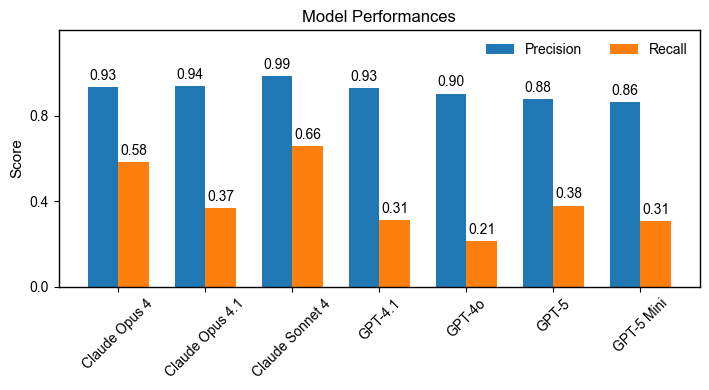

In [ ]:
# ============================================================================
# BAR CHART: OVERALL MODEL PERFORMANCE (DATAFRAME VERSION)
# ============================================================================

# Calculate overall metrics per model
df = metrics_to_dataframe(all_metrics)

df_doi = (
    df.groupby(['model', 'paper'])
    .agg({'TP': 'sum', 'FP': 'sum', 'FN': 'sum'})
    .reset_index()
)

overall = df_doi.groupby('model').sum().reset_index()
overall['precision'] = overall['TP'] / (overall['TP'] + overall['FP'])
overall['recall'] = overall['TP'] / (overall['TP'] + overall['FN'])


# Plot
x = np.arange(len(overall))
width = 0.35

overall_performance_fig, ax = plt.subplots(figsize=(7.2, 4))
rects1 = ax.bar(x - width / 2, overall['precision'], width, label='Precision')
rects2 = ax.bar(x + width / 2, overall['recall'], width, label='Recall')

ax.set_ylabel('Score')
ax.set_title('Model Performances')
ax.set_xticks(x)
ax.set_xticklabels(overall['model'], rotation=45)
ax.set_yticks(np.arange(0, 1.1, 0.4))
ax.set_yticklabels([f'{y:.1f}' for y in np.arange(0, 1.1, 0.4)])
ax.set_ylim(0, 1.2)
ax.legend(loc='upper right', ncol=2, frameon=False)

# Add value labels
for rects, values in [(rects1, overall['precision']), (rects2, overall['recall'])]:
    for rect, val in zip(rects, values):
        height = rect.get_height()
        ax.text(
            rect.get_x() + rect.get_width() / 2.0,
            height + 0.02,
            f'{val:.2f}',
            ha='center',
            va='bottom',
        )

plt.tight_layout()
overall_performance_fig.savefig('overall_performance_bars.pdf')

#### Radar Plot: Recall/Precision per field

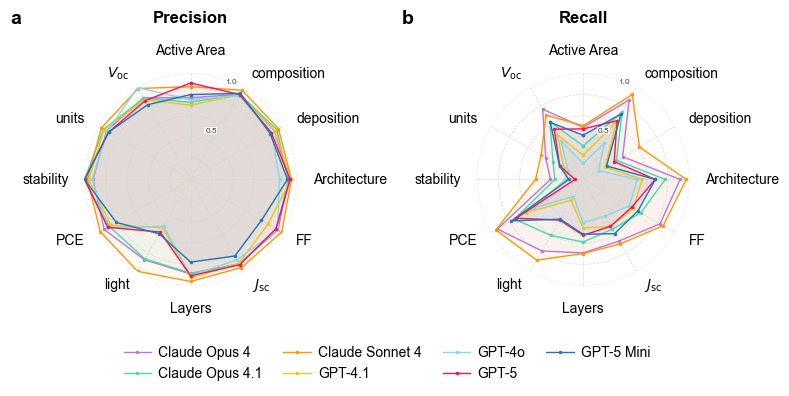

In [ ]:
# Convert to DataFrame and calculate precisions
df = metrics_to_dataframe(all_metrics)
df = add_field_categories(df)
df_recall = df.copy()
df_precision = df.copy()
df_precision = calculate_metrics(df_precision, metric_type='precision')
df_recall = calculate_metrics(df_recall, metric_type='recall')

# Aggregate by model and category
aggregated_precision = (
    df_precision.groupby(['model', 'category'])['score'].mean().reset_index()
)
aggregated_recall = (
    df_recall.groupby(['model', 'category'])['score'].mean().reset_index()
)

# Pivot for radar plot
pivot_precision = aggregated_precision.pivot(
    index='model', columns='category', values='score'
).fillna(0)
pivot_recall = aggregated_recall.pivot(
    index='model', columns='category', values='score'
).fillna(0)


# Prepare Fields
fields = sorted(pivot_precision.columns)
num_fields = len(fields)
angles = [n / float(num_fields) * 2 * pi for n in range(num_fields)]
angles += angles[:1]  # Close the loop


# Formatter
def format_field_name(field):
    field_map = {
        'pce': 'PCE',
        'jsc': r'$J_\mathrm{sc}$',
        'ff': 'FF',
        'voc': r'$V_\mathrm{oc}$',
        'active area': 'Active Area',
        'layers': 'Layers',
        'device architecture': 'Architecture',
    }
    return field_map.get(field.lower(), field)


field_labels = [format_field_name(f) for f in fields]

# ============================================================================
# 3. PLOTTING FUNCTION
# ============================================================================


def draw_radar(ax, pivot_df, title, letter_label, ylim=(0, 1)):
    # A. Setup Grid & Spines
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    ax.spines['polar'].set_visible(False)
    # Very light, thin grid
    ax.grid(color='#D9D9D9', linestyle='--', linewidth=0.5)

    # B. Plot Data (Thinner lines for clarity)
    for model_name in pivot_df.index:
        scores = pivot_df.loc[model_name, fields].tolist()
        values = scores + [scores[0]]
        color = MODEL_COLORS.get(model_name, '#333333')

        ax.plot(
            angles,
            values,
            linewidth=1.0,  # Nature standard line width
            linestyle='-',
            marker='o',
            markersize=2.5,  # Small, crisp markers
            markeredgewidth=0,  # No border on markers for cleanliness
            label=model_name,
            color=color,
        )

        # Extremely subtle fill to keep grid visible
        ax.fill(angles, values, color=color, alpha=0.05)

    # C. Smart Labels (Compact & Aligned)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([])

    # Distance: Closer to center because fonts are smaller (1.15 is sufficient now)
    label_distance = 1.15

    for angle, label in zip(angles[:-1], field_labels):
        angle_norm = angle % (2 * np.pi)

        if np.isclose(angle_norm, 0):  # 12 o'clock
            ha, va = 'center', 'bottom'
        elif 0 < angle_norm < np.pi:  # Right
            ha, va = 'left', 'center'
        elif np.isclose(angle_norm, np.pi):  # 6 o'clock
            ha, va = 'center', 'top'
        else:  # Left
            ha, va = 'right', 'center'

        # Font size 7pt (standard text)
        ax.text(
            angle,
            label_distance,
            label,
            horizontalalignment=ha,
            verticalalignment=va,
            color='black',
        )

    # D. Y-Axis (Radial) - Minimalist
    ax.set_ylim(ylim)
    ax.set_yticklabels([])

    # Minimal ticks: Only show max and mid-point to reduce clutter
    mid_val = (ylim[0] + ylim[1]) / 2
    ticks = [mid_val, ylim[1]]
    r_angle = np.deg2rad(22.5)  # Draw ticks at 22.5 deg to avoid crossing vertical axis

    for y in ticks:
        ax.text(
            r_angle,
            y,
            f'{y:.1f}',
            color='#404040',
            size=6,
            ha='center',
            va='center',
            bbox=dict(facecolor='white', edgecolor='none', alpha=0.8, pad=0.5),
        )

    ax.set_title(title, y=1.2, fontweight='bold', color='black')

    ax.text(
        -0.3,
        1.3,
        letter_label,
        transform=ax.transAxes,
        fontsize=14,
        fontweight='bold',
        va='top',
        ha='right',
        color='black',
    )


# ============================================================================
# 4. GENERATE FIGURE
# ============================================================================

# Width: 7.2 inches (183mm) exactly
# Height: 3.5 inches (approx 89mm) - compact aspect ratio
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7.2, 3.5), subplot_kw={'polar': True})

# Draw Plots
draw_radar(ax1, pivot_precision, 'Precision', 'a', ylim=(0.0, 1.0))
draw_radar(ax2, pivot_recall, 'Recall', 'b', ylim=(0.0, 1.0))

# Shared Legend
handles, labels = ax1.get_legend_handles_labels()
# Very compact legend
fig.legend(
    handles,
    labels,
    loc='lower center',
    bbox_to_anchor=(0.5, -0.1),
    ncol=4,  # 4 columns to be wider/flatter
    frameon=False,
    columnspacing=1.5,
    handletextpad=0.5,
)

# Tight layout with manual adjustments for the legend space
plt.subplots_adjust(
    top=0.82,
    bottom=0.20,  # Space for legend
    left=0.08,
    right=0.92,
    wspace=0.85,
)

# Save as PDF (Vector format required by Nature)
plt.savefig('performance_radar_plot.pdf', dpi=300, format='pdf')

### Comparison with Experts

#### Evaluation Code

In [ ]:
pipeline = ExtractionPipeline(
    model_name='Consensus',
    preprocessor='pymupdf',
    postprocessor='NONE',
    cache_dir='',
    use_cache=True,
)
authors_metrics, authors_recalls, authors_precisions = pipeline._evaluate_multiple(
    EXPERTS_DIR, GROUND_TRUTH_DIR
)

In [12]:
all_metrics['Consensus'] = authors_metrics
experts_included_df = metrics_to_dataframe(all_metrics)

# 1. Get the set of papers that appear with model == "Consensus"
expert_papers = set(
    experts_included_df.loc[experts_included_df['model'] == 'Consensus', 'paper']
)

# 2. Filter the DataFrame
filtered_df = experts_included_df[
    (experts_included_df['model'] == 'Consensus')
    | (
        (experts_included_df['model'] != 'Consensus')
        & (experts_included_df['paper'].isin(expert_papers))
    )
]

In [13]:
# Group by paper and model, sum TP and FP
micro_precision_df = (
    filtered_df.groupby(['paper', 'model'])[['TP', 'FP']].sum().reset_index()
)

# Compute micro-precision
micro_precision_df['precision'] = micro_precision_df['TP'] / (
    micro_precision_df['TP'] + micro_precision_df['FP']
)

<Figure size 640x480 with 0 Axes>

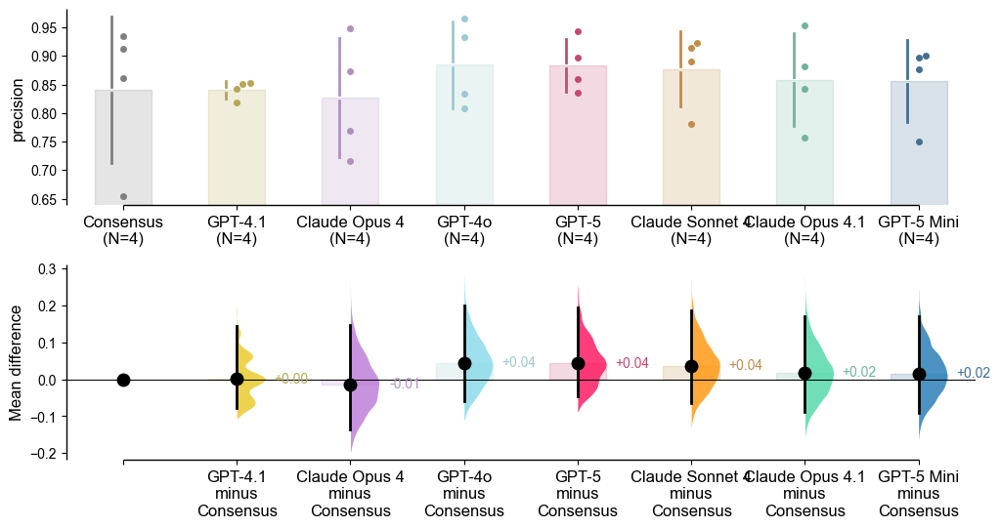

In [14]:
# Only select the papers where both LLMs and experts exist
papers_with_both = micro_precision_df['paper'].value_counts()
papers_with_both = papers_with_both[papers_with_both > 1].index
df_plot = micro_precision_df[micro_precision_df['paper'].isin(papers_with_both)]

# Pivot data so each row is a DOI and each column is a model
df_pivot = df_plot.pivot(
    index='paper', columns='model', values='precision'
).reset_index()

# Melt data for dabest
df_melt = df_pivot.melt(id_vars='paper', var_name='model', value_name='precision')

# Create a dabest object using authors as the control
dabest_data = dabest.load(
    data=df_melt,
    x='model',
    y='precision',
    idx=(
        'Consensus',
        'GPT-4.1',
        'Claude Opus 4',
        'GPT-4o',
        'GPT-5',
        'Claude Sonnet 4',
        'Claude Opus 4.1',
        'GPT-5 Mini',
    ),
)

# Plot mean difference against authors
plt.figure()
mean_fig = dabest_data.mean_diff.plot(
    raw_marker_size=4,
    custom_palette=MODEL_COLORS,
)

#### Overlapping extractions spider plots

In [ ]:
human_metrics = {}  # model_name -> paper_doi -> {field: score}
human_precs_and_recalls = {}

HUMANS_DIR = EXTRACTIONS_DIR / 'humans'
DEV_DIR = DATA_DIR / 'ground_truth' / 'dev'
# Evaluate all models
for model_dir in HUMANS_DIR.iterdir():
    if not model_dir.is_dir():
        continue

    model_name = model_dir.name
    print(f'Evaluating model: {model_name}')

    pipeline = ExtractionPipeline(
        model_name=model_name,
        preprocessor='pymupdf',
        postprocessor='NONE',
        cache_dir='',
        use_cache=True,
    )
    model_metrics, avg_recalls, avg_precisions = pipeline._evaluate_multiple(
        model_dir, DEV_DIR
    )

    human_precs_and_recalls[model_name] = {
        'precision': avg_precisions,
        'recall': avg_recalls,
    }
    human_metrics[model_name] = model_metrics

sonnet_4_metrics, s_rec, s_prec = pipeline._evaluate_multiple(
    EXTRACTIONS_DIR / 'claude-sonnet-4-20250514/', DEV_DIR
)
human_metrics['Claude Sonnet 4'] = sonnet_4_metrics

##### What dois match across our extractions

In [17]:
from collections import defaultdict

doi_to_groups = defaultdict(list)

for group, dois in human_metrics.items():
    for doi in dois:
        doi_to_groups[doi].append(group)

print('DOI matches across groups:\n')
for doi, groups in doi_to_groups.items():
    if len(groups) > 1:
        print(f'{doi} -> {", ".join(groups)}')

DOI matches across groups:

10.1021--acs.chemmater.8b01521.json -> Consensus, Kit, Seal, Robin, Claude Sonnet 4
10.1021--acsaem.9b01928.json -> Consensus, Bee, Panda, Seal, Dove, Claude Sonnet 4
10.1002--adfm.201904856.json -> Consensus, Bee, Fox, Kit, Claude Sonnet 4
10.1039--c7nr04692h.json -> Consensus, Bear, Kit, Dove, Claude Sonnet 4
10.1002--adma.202302143.json -> Consensus, Bee, Robin, Claude Sonnet 4
10.1002--solr.201900370.json -> Consensus, Bear, Lark, Kit, Claude Sonnet 4
10.1039--c5dt02388b.json -> Consensus, Bear, Kit, Otto, Claude Sonnet 4
10.1016--j.nanoen.2016.05.023.json -> Consensus, Bear, Panda, Lark, Seal, Dove, Hawk, Claude Sonnet 4
10.1002--adfm.201500335.json -> Consensus, Bee, Panda, Dove, Claude Sonnet 4
10.1016--j.matlet.2016.07.004.json -> Consensus, Bear, Lark, Dove, Claude Sonnet 4


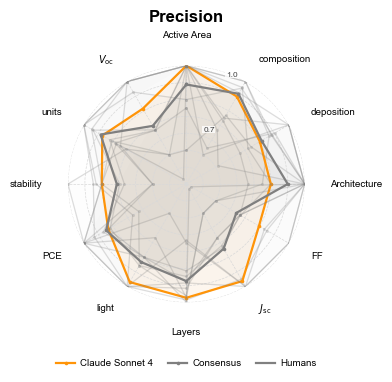

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from math import pi
from matplotlib.lines import Line2D

# ---------------------------------------------------------------------
# 1) DATA PREP (same as yours)
# ---------------------------------------------------------------------
df = metrics_to_dataframe(human_metrics)
df = add_field_categories(df)
df = calculate_metrics(df, metric_type='precision')

aggregated = df.groupby(['model', 'category'])['score'].mean().reset_index()
pivot_df = aggregated.pivot(index='model', columns='category', values='score').fillna(0)

fields = sorted(pivot_df.columns)
num_fields = len(fields)
angles = [n / float(num_fields) * 2 * pi for n in range(num_fields)]
angles += angles[:1]  # close loop


# Field name formatter (same style as template)
def format_field_name(field):
    field_map = {
        'pce': 'PCE',
        'jsc': r'$J_\mathrm{sc}$',
        'ff': 'FF',
        'voc': r'$V_\mathrm{oc}$',
        'active area': 'active area',
        'layers': 'layers',
        'device architecture': 'architecture',
    }
    return field_map.get(str(field).lower(), field)


field_labels = [format_field_name(f) for f in fields]


# ---------------------------------------------------------------------
# 2) PLOTTING (Nature-like style, like subfigure a)
# ---------------------------------------------------------------------
def draw_radar_precision_like_a(
    ax,
    pivot_df,
    title='Precision',
    ylim=(0.3, 1.0),
    highlight_models=('Consensus', 'Claude Sonnet 4'),
):
    # A) Grid & spines
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)
    ax.spines['polar'].set_visible(False)
    ax.grid(color='#D9D9D9', linestyle='--', linewidth=0.5)

    # B) Plot data (highlight vs dim)
    for model_name in pivot_df.index:
        scores = pivot_df.loc[model_name, fields].tolist()
        values = scores + [scores[0]]

        if model_name in highlight_models:
            color = MODEL_COLORS.get(model_name, '#333333')
            line_alpha = 1.0
            fill_alpha = 0.06
            lw = 1.6
            ms = 2.6
        else:
            color = 'gray'
            line_alpha = 0.25
            fill_alpha = 0.015
            lw = 0.9
            ms = 2.2

        ax.plot(
            angles,
            values,
            linewidth=lw,
            linestyle='-',
            marker='o',
            markersize=ms,
            markeredgewidth=0,
            color=color,
            alpha=line_alpha,
            label=model_name,
        )
        ax.fill(angles, values, color=color, alpha=fill_alpha)

    # C) Axis limits
    ax.set_ylim(ylim)

    # D) X labels (manual placement like template)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels([])

    label_distance = 1.15
    for angle, label in zip(angles[:-1], field_labels):
        angle_norm = angle % (2 * np.pi)

        if np.isclose(angle_norm, 0):  # 12 o'clock
            ha, va = 'center', 'bottom'
        elif 0 < angle_norm < np.pi:  # right half
            ha, va = 'left', 'center'
        elif np.isclose(angle_norm, np.pi):  # 6 o'clock
            ha, va = 'center', 'top'
        else:  # left half
            ha, va = 'right', 'center'

        ax.text(
            angle,
            label_distance,
            label,
            ha=ha,
            va=va,
            color='black',
            fontsize=7,
        )

    # E) Radial labels (minimal, with small white bbox like template)
    ax.set_yticklabels([])
    mid_val = (ylim[0] + ylim[1]) / 2
    ticks = [mid_val, ylim[1]]
    r_angle = np.deg2rad(22.5)

    for y in ticks:
        ax.text(
            r_angle,
            y,
            f'{y:.1f}',
            color='#404040',
            size=6,
            ha='center',
            va='center',
            bbox=dict(facecolor='white', edgecolor='none', alpha=0.8, pad=0.5),
        )

    ax.set_title(title, y=1.15, fontweight='bold', color='black')


# ---------------------------------------------------------------------
# 3) FIGURE + LEGEND (compact)
# ---------------------------------------------------------------------
fig = plt.figure(figsize=(7.2, 3.5))
ax = plt.subplot(111, polar=True)

draw_radar_precision_like_a(
    ax,
    pivot_df,
    title='Precision',
    ylim=(0.3, 1.0),
    highlight_models=('Consensus', 'Claude Sonnet 4'),
)

# Keep legend similar to your intent: only highlights + "Humans" entry
humans_legend_handle = Line2D(
    [0], [0], color='gray', linewidth=1.6, alpha=1.0, label='Humans'
)

handles, labels = ax.get_legend_handles_labels()
allowed = {'Consensus', 'Claude Sonnet 4'}
filtered = [(h, l) for h, l in zip(handles, labels) if l in allowed]

if filtered:
    handles, labels = zip(*filtered)
    handles, labels = list(handles), list(labels)
else:
    handles, labels = [], []

handles += [humans_legend_handle]
labels += ['Humans']

fig.legend(
    handles,
    labels,
    loc='lower center',
    bbox_to_anchor=(0.5, -0.08),
    ncol=3,
    frameon=False,
    columnspacing=1.5,
    handletextpad=0.5,
    fontsize=7,
)

plt.subplots_adjust(top=0.82, bottom=0.22, left=0.08, right=0.92)
plt.tight_layout()
plt.savefig('human_precision_radar.pdf', dpi=300, format='pdf')